# Import relevant packages

In [1]:
# Manually add environment's bin dir to the path inside notebook to run tensorboard
from os import environ
#PATH = os.getenv('PATH')
#%env PATH=/home/theghub/naureenk/.conda/envs/crev/bin:$PATH
    
# Magic command to load tensorboard extension
#%load_ext tensorboard
# Mute TF 2.12 Bug Warnings (Before importing tensorflow)
environ['TF_CPP_MIN_LOG_LEVEL'] = '2' 
from sys import path
# Appending the U-net package folder
path.append("./src/")
import unet
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import losses, metrics
from tensorflow.keras.layers import Input, Conv2D, Dropout, MaxPooling2D, Activation, ReLU
from tensorflow.keras.layers import BatchNormalization, Conv2DTranspose, Concatenate
from tensorflow.keras.models import Model, Sequential
print(f"Tensorflow ver. {tf.__version__}")


Tensorflow ver. 2.15.0


## TF input pipeline for U-Net

In [2]:
IMG_SIZE = (512,512)
#function to read image and mask from file
def read_image(image_name):
    image = tf.io.read_file(image_name)
    image = tf.image.decode_png(image, channels=1)
    image = tf.image.resize(image, IMG_SIZE)
    image = tf.cast(image, tf.float32)/255.0
    return image
    
def read_mask(mask_name):    
    mask = tf.io.read_file(mask_name)
    mask = tf.image.decode_png(mask, channels=1)
    mask = tf.image.resize(mask, IMG_SIZE)
    mask = tf.cast(mask, tf.uint8)
    #mask = tf.expand_dims(mask, axis=-1)
    return mask
    
# Create TRAIN TF dataset of Images and Labels separately and then map the files to stream of images and labels
train_image_dataset = tf.data.Dataset.list_files("./gris/Images_HH_median/Train/*.png", shuffle=False)
train_image_dataset = train_image_dataset.map(read_image, num_parallel_calls=tf.data.AUTOTUNE)
train_label_dataset = tf.data.Dataset.list_files("./gris/Labels with updated crevasse and stream shapes/Train/*.png", shuffle=False)
train_label_dataset = train_label_dataset.map(read_mask, num_parallel_calls=tf.data.AUTOTUNE)
# Combine both datasets
train_ds = tf.data.Dataset.zip((train_image_dataset,train_label_dataset))
# Add data augmentation

# Create VALIDATION TF dataset of Images and Labels separately and then map the files to stream of images and labels
valid_image_dataset = tf.data.Dataset.list_files("./gris/Images_HH_median/Valid/*.png", shuffle=False)
valid_image_dataset = valid_image_dataset.map(read_image, num_parallel_calls=tf.data.AUTOTUNE)
valid_label_dataset = tf.data.Dataset.list_files("./gris/Labels with updated crevasse and stream shapes/Valid/*.png", shuffle=False)
valid_label_dataset = valid_label_dataset.map(read_mask, num_parallel_calls=tf.data.AUTOTUNE)
# Combine both datasets
valid_ds = tf.data.Dataset.zip((valid_image_dataset,valid_label_dataset))
#for element in train_ds:
#    print(element)


## Build unet model with parameters

In [3]:
unet_model = unet.build_model(nx = 512, ny = 512,
                              channels=1,
                              num_classes=3,
                              layer_depth=3,
                              filters_root=16,
                              pool_size=2,
                              dropout_rate=0.06,
                              padding="same",
                              activation="relu",
                              kernel_initializer='glorot_uniform',
                              kernel_regularizer=tf.keras.regularizers.L1L2(l1=0.0, l2=0.01)
)

unet.finalize_model(unet_model,
                    loss=losses.SparseCategoricalCrossentropy(from_logits=False),
                    optimizer=tf.keras.optimizers.experimental.SGD(learning_rate=0.07, momentum=0.1),
                    #optimizer=tf.keras.optimizers.Adam(learning_rate=0.002, epsilon=0.01),
                    metrics=[tf.keras.metrics.SparseCategoricalAccuracy(),
                            tf.keras.metrics.IoU(num_classes=3,target_class_ids=[1],ignore_class=[0]),
                            tf.keras.metrics.IoU(num_classes=3,target_class_ids=[2],ignore_class=[0]),
                            tf.keras.metrics.IoU(num_classes=3,target_class_ids=[0]),
                            tf.keras.metrics.MeanIoU(num_classes=3,sparse_y_true=True,sparse_y_pred=False)],
                    dice_coefficient=False,
                    mean_iou=False,
                    auc=False,
)
#unet_model.summary()

In [4]:
# To suppress unnecessary warnings
from absl import logging
logging.set_verbosity(logging.ERROR)

#callbacks = [tf.keras.callbacks.EarlyStopping(patience=3, monitor='val_loss'),
             #tf.keras.callbacks.TensorBoard(log_dir='3class_unet_8/28')]
trainer = unet.Trainer(name="crevasse_data", tensorboard_images_callback=False)
trainer.fit(unet_model,
            train_dataset = train_ds,
            validation_dataset = valid_ds,
            epochs=1000,
            batch_size=1)

1/1 [==============================] - 0s 414ms/step
Epoch 1/1000

36/36 [==============================] - ETA: 0s - loss: 0.8684 - sparse_categorical_accuracy: 0.7262 - io_u: 0.0000e+00 - mean_io_u: 0.2448INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 14s 348ms/step - loss: 0.8684 - sparse_categorical_accuracy: 0.7262 - io_u: 0.0000e+00 - mean_io_u: 0.2448 - val_loss: 0.6735 - val_sparse_categorical_accuracy: 0.7785 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.2595 - learning_rate: 0.0700
Epoch 2/1000
36/36 [==============================] - ETA: 0s - loss: 0.6842 - sparse_categorical_accuracy: 0.7315 - io_u: 0.0000e+00 - mean_io_u: 0.2484INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 315ms/step - loss: 0.6842 - sparse_categorical_accuracy: 0.7315 - io_u: 0.0000e+00 - mean_io_u: 0.2484 - val_loss: 0.5518 - val_sparse_categorical_accuracy: 0.7785 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.2595 - learning_rate: 0.0700
Epoch 3/1000
36/36 [==============================] - ETA: 0s - loss: 0.5966 - sparse_categorical_accuracy: 0.7752 - io_u: 0.0000e+00 - mean_io_u: 0.3753INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 311ms/step - loss: 0.5966 - sparse_categorical_accuracy: 0.7752 - io_u: 0.0000e+00 - mean_io_u: 0.3753 - val_loss: 0.3870 - val_sparse_categorical_accuracy: 0.8578 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.4137 - learning_rate: 0.0700
Epoch 4/1000
36/36 [==============================] - ETA: 0s - loss: 0.5131 - sparse_categorical_accuracy: 0.8282 - io_u: 0.0000e+00 - mean_io_u: 0.4385INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 12s 323ms/step - loss: 0.5131 - sparse_categorical_accuracy: 0.8282 - io_u: 0.0000e+00 - mean_io_u: 0.4385 - val_loss: 0.3336 - val_sparse_categorical_accuracy: 0.8973 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.4959 - learning_rate: 0.0700
Epoch 5/1000
36/36 [==============================] - ETA: 0s - loss: 0.4498 - sparse_categorical_accuracy: 0.8457 - io_u: 0.0000e+00 - mean_io_u: 0.4624INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 316ms/step - loss: 0.4498 - sparse_categorical_accuracy: 0.8457 - io_u: 0.0000e+00 - mean_io_u: 0.4624 - val_loss: 0.2974 - val_sparse_categorical_accuracy: 0.9003 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5073 - learning_rate: 0.0700
Epoch 6/1000
36/36 [==============================] - ETA: 0s - loss: 0.4396 - sparse_categorical_accuracy: 0.8460 - io_u: 0.0000e+00 - mean_io_u: 0.4633INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 306ms/step - loss: 0.4396 - sparse_categorical_accuracy: 0.8460 - io_u: 0.0000e+00 - mean_io_u: 0.4633 - val_loss: 0.2946 - val_sparse_categorical_accuracy: 0.9008 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5068 - learning_rate: 0.0700
Epoch 7/1000
36/36 [==============================] - ETA: 0s - loss: 0.4270 - sparse_categorical_accuracy: 0.8496 - io_u: 0.0000e+00 - mean_io_u: 0.4678INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 310ms/step - loss: 0.4270 - sparse_categorical_accuracy: 0.8496 - io_u: 0.0000e+00 - mean_io_u: 0.4678 - val_loss: 0.2928 - val_sparse_categorical_accuracy: 0.9010 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5064 - learning_rate: 0.0700
Epoch 8/1000
36/36 [==============================] - ETA: 0s - loss: 0.4203 - sparse_categorical_accuracy: 0.8522 - io_u: 0.0000e+00 - mean_io_u: 0.4710INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 315ms/step - loss: 0.4203 - sparse_categorical_accuracy: 0.8522 - io_u: 0.0000e+00 - mean_io_u: 0.4710 - val_loss: 0.2911 - val_sparse_categorical_accuracy: 0.9012 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5064 - learning_rate: 0.0700
Epoch 9/1000
36/36 [==============================] - ETA: 0s - loss: 0.4157 - sparse_categorical_accuracy: 0.8542 - io_u: 0.0000e+00 - mean_io_u: 0.4735INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 312ms/step - loss: 0.4157 - sparse_categorical_accuracy: 0.8542 - io_u: 0.0000e+00 - mean_io_u: 0.4735 - val_loss: 0.2897 - val_sparse_categorical_accuracy: 0.9014 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5065 - learning_rate: 0.0700
Epoch 10/1000
36/36 [==============================] - ETA: 0s - loss: 0.4123 - sparse_categorical_accuracy: 0.8557 - io_u: 0.0000e+00 - mean_io_u: 0.4754INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 12s 324ms/step - loss: 0.4123 - sparse_categorical_accuracy: 0.8557 - io_u: 0.0000e+00 - mean_io_u: 0.4754 - val_loss: 0.2883 - val_sparse_categorical_accuracy: 0.9018 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5068 - learning_rate: 0.0700
Epoch 11/1000
36/36 [==============================] - ETA: 0s - loss: 0.4098 - sparse_categorical_accuracy: 0.8569 - io_u: 0.0000e+00 - mean_io_u: 0.4769INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 12s 323ms/step - loss: 0.4098 - sparse_categorical_accuracy: 0.8569 - io_u: 0.0000e+00 - mean_io_u: 0.4769 - val_loss: 0.2868 - val_sparse_categorical_accuracy: 0.9022 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5074 - learning_rate: 0.0700
Epoch 12/1000
36/36 [==============================] - ETA: 0s - loss: 0.4076 - sparse_categorical_accuracy: 0.8580 - io_u: 0.0000e+00 - mean_io_u: 0.4784INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 310ms/step - loss: 0.4076 - sparse_categorical_accuracy: 0.8580 - io_u: 0.0000e+00 - mean_io_u: 0.4784 - val_loss: 0.2854 - val_sparse_categorical_accuracy: 0.9026 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5079 - learning_rate: 0.0700
Epoch 13/1000
36/36 [==============================] - ETA: 0s - loss: 0.4049 - sparse_categorical_accuracy: 0.8589 - io_u: 0.0000e+00 - mean_io_u: 0.4795INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 313ms/step - loss: 0.4049 - sparse_categorical_accuracy: 0.8589 - io_u: 0.0000e+00 - mean_io_u: 0.4795 - val_loss: 0.2838 - val_sparse_categorical_accuracy: 0.9031 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5087 - learning_rate: 0.0700
Epoch 14/1000
36/36 [==============================] - ETA: 0s - loss: 0.4024 - sparse_categorical_accuracy: 0.8598 - io_u: 0.0000e+00 - mean_io_u: 0.4807INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 306ms/step - loss: 0.4024 - sparse_categorical_accuracy: 0.8598 - io_u: 0.0000e+00 - mean_io_u: 0.4807 - val_loss: 0.2824 - val_sparse_categorical_accuracy: 0.9033 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5090 - learning_rate: 0.0700
Epoch 15/1000
36/36 [==============================] - ETA: 0s - loss: 0.4000 - sparse_categorical_accuracy: 0.8606 - io_u: 0.0000e+00 - mean_io_u: 0.4817INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 315ms/step - loss: 0.4000 - sparse_categorical_accuracy: 0.8606 - io_u: 0.0000e+00 - mean_io_u: 0.4817 - val_loss: 0.2810 - val_sparse_categorical_accuracy: 0.9035 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5090 - learning_rate: 0.0700
Epoch 16/1000
36/36 [==============================] - ETA: 0s - loss: 0.3975 - sparse_categorical_accuracy: 0.8615 - io_u: 0.0000e+00 - mean_io_u: 0.4829INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 312ms/step - loss: 0.3975 - sparse_categorical_accuracy: 0.8615 - io_u: 0.0000e+00 - mean_io_u: 0.4829 - val_loss: 0.2796 - val_sparse_categorical_accuracy: 0.9037 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5089 - learning_rate: 0.0700
Epoch 17/1000
36/36 [==============================] - ETA: 0s - loss: 0.3952 - sparse_categorical_accuracy: 0.8624 - io_u: 0.0000e+00 - mean_io_u: 0.4839INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 310ms/step - loss: 0.3952 - sparse_categorical_accuracy: 0.8624 - io_u: 0.0000e+00 - mean_io_u: 0.4839 - val_loss: 0.2785 - val_sparse_categorical_accuracy: 0.9039 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5088 - learning_rate: 0.0700
Epoch 18/1000
36/36 [==============================] - ETA: 0s - loss: 0.3929 - sparse_categorical_accuracy: 0.8635 - io_u: 0.0000e+00 - mean_io_u: 0.4852INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 319ms/step - loss: 0.3929 - sparse_categorical_accuracy: 0.8635 - io_u: 0.0000e+00 - mean_io_u: 0.4852 - val_loss: 0.2775 - val_sparse_categorical_accuracy: 0.9041 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5090 - learning_rate: 0.0700
Epoch 19/1000
36/36 [==============================] - ETA: 0s - loss: 0.3909 - sparse_categorical_accuracy: 0.8642 - io_u: 0.0000e+00 - mean_io_u: 0.4861INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 315ms/step - loss: 0.3909 - sparse_categorical_accuracy: 0.8642 - io_u: 0.0000e+00 - mean_io_u: 0.4861 - val_loss: 0.2767 - val_sparse_categorical_accuracy: 0.9044 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5091 - learning_rate: 0.0700
Epoch 20/1000
36/36 [==============================] - ETA: 0s - loss: 0.3889 - sparse_categorical_accuracy: 0.8652 - io_u: 0.0000e+00 - mean_io_u: 0.4873INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 316ms/step - loss: 0.3889 - sparse_categorical_accuracy: 0.8652 - io_u: 0.0000e+00 - mean_io_u: 0.4873 - val_loss: 0.2755 - val_sparse_categorical_accuracy: 0.9048 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5098 - learning_rate: 0.0700
Epoch 21/1000
36/36 [==============================] - ETA: 0s - loss: 0.3869 - sparse_categorical_accuracy: 0.8659 - io_u: 0.0000e+00 - mean_io_u: 0.4883INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 320ms/step - loss: 0.3869 - sparse_categorical_accuracy: 0.8659 - io_u: 0.0000e+00 - mean_io_u: 0.4883 - val_loss: 0.2746 - val_sparse_categorical_accuracy: 0.9051 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5103 - learning_rate: 0.0700
Epoch 22/1000
36/36 [==============================] - ETA: 0s - loss: 0.3850 - sparse_categorical_accuracy: 0.8666 - io_u: 0.0000e+00 - mean_io_u: 0.4891INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 318ms/step - loss: 0.3850 - sparse_categorical_accuracy: 0.8666 - io_u: 0.0000e+00 - mean_io_u: 0.4891 - val_loss: 0.2728 - val_sparse_categorical_accuracy: 0.9059 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5119 - learning_rate: 0.0700
Epoch 23/1000
36/36 [==============================] - ETA: 0s - loss: 0.3829 - sparse_categorical_accuracy: 0.8674 - io_u: 0.0000e+00 - mean_io_u: 0.4901INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 309ms/step - loss: 0.3829 - sparse_categorical_accuracy: 0.8674 - io_u: 0.0000e+00 - mean_io_u: 0.4901 - val_loss: 0.2714 - val_sparse_categorical_accuracy: 0.9063 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5128 - learning_rate: 0.0700
Epoch 24/1000
36/36 [==============================] - ETA: 0s - loss: 0.3808 - sparse_categorical_accuracy: 0.8681 - io_u: 0.0000e+00 - mean_io_u: 0.4911INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 316ms/step - loss: 0.3808 - sparse_categorical_accuracy: 0.8681 - io_u: 0.0000e+00 - mean_io_u: 0.4911 - val_loss: 0.2703 - val_sparse_categorical_accuracy: 0.9066 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5136 - learning_rate: 0.0700
Epoch 25/1000
36/36 [==============================] - ETA: 0s - loss: 0.3786 - sparse_categorical_accuracy: 0.8689 - io_u: 0.0000e+00 - mean_io_u: 0.4921INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 12s 322ms/step - loss: 0.3786 - sparse_categorical_accuracy: 0.8689 - io_u: 0.0000e+00 - mean_io_u: 0.4921 - val_loss: 0.2692 - val_sparse_categorical_accuracy: 0.9070 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5143 - learning_rate: 0.0700
Epoch 26/1000
36/36 [==============================] - ETA: 0s - loss: 0.3768 - sparse_categorical_accuracy: 0.8696 - io_u: 0.0000e+00 - mean_io_u: 0.4930INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 310ms/step - loss: 0.3768 - sparse_categorical_accuracy: 0.8696 - io_u: 0.0000e+00 - mean_io_u: 0.4930 - val_loss: 0.2686 - val_sparse_categorical_accuracy: 0.9072 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5149 - learning_rate: 0.0700
Epoch 27/1000
36/36 [==============================] - ETA: 0s - loss: 0.3752 - sparse_categorical_accuracy: 0.8701 - io_u: 0.0000e+00 - mean_io_u: 0.4938INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 318ms/step - loss: 0.3752 - sparse_categorical_accuracy: 0.8701 - io_u: 0.0000e+00 - mean_io_u: 0.4938 - val_loss: 0.2682 - val_sparse_categorical_accuracy: 0.9074 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5152 - learning_rate: 0.0700
Epoch 28/1000
36/36 [==============================] - ETA: 0s - loss: 0.3737 - sparse_categorical_accuracy: 0.8705 - io_u: 0.0000e+00 - mean_io_u: 0.4942INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 12s 322ms/step - loss: 0.3737 - sparse_categorical_accuracy: 0.8705 - io_u: 0.0000e+00 - mean_io_u: 0.4942 - val_loss: 0.2674 - val_sparse_categorical_accuracy: 0.9077 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5159 - learning_rate: 0.0700
Epoch 29/1000
36/36 [==============================] - ETA: 0s - loss: 0.3725 - sparse_categorical_accuracy: 0.8709 - io_u: 0.0000e+00 - mean_io_u: 0.4948INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 310ms/step - loss: 0.3725 - sparse_categorical_accuracy: 0.8709 - io_u: 0.0000e+00 - mean_io_u: 0.4948 - val_loss: 0.2671 - val_sparse_categorical_accuracy: 0.9078 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5161 - learning_rate: 0.0700
Epoch 30/1000
36/36 [==============================] - ETA: 0s - loss: 0.3710 - sparse_categorical_accuracy: 0.8714 - io_u: 0.0000e+00 - mean_io_u: 0.4955INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 312ms/step - loss: 0.3710 - sparse_categorical_accuracy: 0.8714 - io_u: 0.0000e+00 - mean_io_u: 0.4955 - val_loss: 0.2668 - val_sparse_categorical_accuracy: 0.9080 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5166 - learning_rate: 0.0700
Epoch 31/1000
36/36 [==============================] - ETA: 0s - loss: 0.3698 - sparse_categorical_accuracy: 0.8719 - io_u: 0.0000e+00 - mean_io_u: 0.4963INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 312ms/step - loss: 0.3698 - sparse_categorical_accuracy: 0.8719 - io_u: 0.0000e+00 - mean_io_u: 0.4963 - val_loss: 0.2662 - val_sparse_categorical_accuracy: 0.9082 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5171 - learning_rate: 0.0700
Epoch 32/1000
36/36 [==============================] - ETA: 0s - loss: 0.3688 - sparse_categorical_accuracy: 0.8722 - io_u: 0.0000e+00 - mean_io_u: 0.4966INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 317ms/step - loss: 0.3688 - sparse_categorical_accuracy: 0.8722 - io_u: 0.0000e+00 - mean_io_u: 0.4966 - val_loss: 0.2659 - val_sparse_categorical_accuracy: 0.9083 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5174 - learning_rate: 0.0700
Epoch 33/1000
36/36 [==============================] - ETA: 0s - loss: 0.3678 - sparse_categorical_accuracy: 0.8724 - io_u: 0.0000e+00 - mean_io_u: 0.4970INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 312ms/step - loss: 0.3678 - sparse_categorical_accuracy: 0.8724 - io_u: 0.0000e+00 - mean_io_u: 0.4970 - val_loss: 0.2654 - val_sparse_categorical_accuracy: 0.9086 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5180 - learning_rate: 0.0700
Epoch 34/1000
36/36 [==============================] - ETA: 0s - loss: 0.3667 - sparse_categorical_accuracy: 0.8728 - io_u: 0.0000e+00 - mean_io_u: 0.4976INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 306ms/step - loss: 0.3667 - sparse_categorical_accuracy: 0.8728 - io_u: 0.0000e+00 - mean_io_u: 0.4976 - val_loss: 0.2650 - val_sparse_categorical_accuracy: 0.9087 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5184 - learning_rate: 0.0700
Epoch 35/1000
36/36 [==============================] - ETA: 0s - loss: 0.3660 - sparse_categorical_accuracy: 0.8732 - io_u: 0.0000e+00 - mean_io_u: 0.4981INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 318ms/step - loss: 0.3660 - sparse_categorical_accuracy: 0.8732 - io_u: 0.0000e+00 - mean_io_u: 0.4981 - val_loss: 0.2645 - val_sparse_categorical_accuracy: 0.9090 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5190 - learning_rate: 0.0700
Epoch 36/1000
36/36 [==============================] - ETA: 0s - loss: 0.3651 - sparse_categorical_accuracy: 0.8735 - io_u: 0.0000e+00 - mean_io_u: 0.4986INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 309ms/step - loss: 0.3651 - sparse_categorical_accuracy: 0.8735 - io_u: 0.0000e+00 - mean_io_u: 0.4986 - val_loss: 0.2640 - val_sparse_categorical_accuracy: 0.9091 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5194 - learning_rate: 0.0700
Epoch 37/1000
36/36 [==============================] - ETA: 0s - loss: 0.3640 - sparse_categorical_accuracy: 0.8739 - io_u: 0.0000e+00 - mean_io_u: 0.4992INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 315ms/step - loss: 0.3640 - sparse_categorical_accuracy: 0.8739 - io_u: 0.0000e+00 - mean_io_u: 0.4992 - val_loss: 0.2636 - val_sparse_categorical_accuracy: 0.9093 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5199 - learning_rate: 0.0700
Epoch 38/1000
36/36 [==============================] - ETA: 0s - loss: 0.3633 - sparse_categorical_accuracy: 0.8741 - io_u: 0.0000e+00 - mean_io_u: 0.4994INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 320ms/step - loss: 0.3633 - sparse_categorical_accuracy: 0.8741 - io_u: 0.0000e+00 - mean_io_u: 0.4994 - val_loss: 0.2634 - val_sparse_categorical_accuracy: 0.9095 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5202 - learning_rate: 0.0700
Epoch 39/1000
36/36 [==============================] - ETA: 0s - loss: 0.3624 - sparse_categorical_accuracy: 0.8745 - io_u: 0.0000e+00 - mean_io_u: 0.5000INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 312ms/step - loss: 0.3624 - sparse_categorical_accuracy: 0.8745 - io_u: 0.0000e+00 - mean_io_u: 0.5000 - val_loss: 0.2628 - val_sparse_categorical_accuracy: 0.9097 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5208 - learning_rate: 0.0700
Epoch 40/1000
36/36 [==============================] - ETA: 0s - loss: 0.3619 - sparse_categorical_accuracy: 0.8747 - io_u: 0.0000e+00 - mean_io_u: 0.5003INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 312ms/step - loss: 0.3619 - sparse_categorical_accuracy: 0.8747 - io_u: 0.0000e+00 - mean_io_u: 0.5003 - val_loss: 0.2625 - val_sparse_categorical_accuracy: 0.9098 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5211 - learning_rate: 0.0700
Epoch 41/1000
36/36 [==============================] - ETA: 0s - loss: 0.3608 - sparse_categorical_accuracy: 0.8751 - io_u: 0.0000e+00 - mean_io_u: 0.5009INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 317ms/step - loss: 0.3608 - sparse_categorical_accuracy: 0.8751 - io_u: 0.0000e+00 - mean_io_u: 0.5009 - val_loss: 0.2621 - val_sparse_categorical_accuracy: 0.9100 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5217 - learning_rate: 0.0700
Epoch 42/1000
36/36 [==============================] - ETA: 0s - loss: 0.3603 - sparse_categorical_accuracy: 0.8753 - io_u: 0.0000e+00 - mean_io_u: 0.5013INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 313ms/step - loss: 0.3603 - sparse_categorical_accuracy: 0.8753 - io_u: 0.0000e+00 - mean_io_u: 0.5013 - val_loss: 0.2617 - val_sparse_categorical_accuracy: 0.9102 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5221 - learning_rate: 0.0700
Epoch 43/1000
36/36 [==============================] - ETA: 0s - loss: 0.3593 - sparse_categorical_accuracy: 0.8756 - io_u: 0.0000e+00 - mean_io_u: 0.5017INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 314ms/step - loss: 0.3593 - sparse_categorical_accuracy: 0.8756 - io_u: 0.0000e+00 - mean_io_u: 0.5017 - val_loss: 0.2614 - val_sparse_categorical_accuracy: 0.9103 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5224 - learning_rate: 0.0700
Epoch 44/1000
36/36 [==============================] - ETA: 0s - loss: 0.3588 - sparse_categorical_accuracy: 0.8758 - io_u: 0.0000e+00 - mean_io_u: 0.5020INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 315ms/step - loss: 0.3588 - sparse_categorical_accuracy: 0.8758 - io_u: 0.0000e+00 - mean_io_u: 0.5020 - val_loss: 0.2609 - val_sparse_categorical_accuracy: 0.9105 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5227 - learning_rate: 0.0700
Epoch 45/1000
36/36 [==============================] - ETA: 0s - loss: 0.3582 - sparse_categorical_accuracy: 0.8761 - io_u: 0.0000e+00 - mean_io_u: 0.5024INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 319ms/step - loss: 0.3582 - sparse_categorical_accuracy: 0.8761 - io_u: 0.0000e+00 - mean_io_u: 0.5024 - val_loss: 0.2606 - val_sparse_categorical_accuracy: 0.9106 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5231 - learning_rate: 0.0700
Epoch 46/1000
36/36 [==============================] - ETA: 0s - loss: 0.3573 - sparse_categorical_accuracy: 0.8764 - io_u: 0.0000e+00 - mean_io_u: 0.5028INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 316ms/step - loss: 0.3573 - sparse_categorical_accuracy: 0.8764 - io_u: 0.0000e+00 - mean_io_u: 0.5028 - val_loss: 0.2603 - val_sparse_categorical_accuracy: 0.9107 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5234 - learning_rate: 0.0700
Epoch 47/1000
36/36 [==============================] - 9s 250ms/step - loss: 0.3570 - sparse_categorical_accuracy: 0.8764 - io_u: 0.0000e+00 - mean_io_u: 0.5030 - val_loss: 0.2603 - val_sparse_categorical_accuracy: 0.9108 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5239 - learning_rate: 0.0700
Epoch 48/1000
36/36 [==============================] - ETA: 0s - loss: 0.3560 - sparse_categorical_accuracy: 0.8768 - io_u: 0.0000e+00 - mean_io_u: 0.5036INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 318ms/step - loss: 0.3560 - sparse_categorical_accuracy: 0.8768 - io_u: 0.0000e+00 - mean_io_u: 0.5036 - val_loss: 0.2600 - val_sparse_categorical_accuracy: 0.9109 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5248 - learning_rate: 0.0700
Epoch 49/1000
36/36 [==============================] - 9s 254ms/step - loss: 0.3555 - sparse_categorical_accuracy: 0.8770 - io_u: 0.0000e+00 - mean_io_u: 0.5039 - val_loss: 0.2601 - val_sparse_categorical_accuracy: 0.9110 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5254 - learning_rate: 0.0700
Epoch 50/1000
36/36 [==============================] - ETA: 0s - loss: 0.3547 - sparse_categorical_accuracy: 0.8772 - io_u: 0.0000e+00 - mean_io_u: 0.5043INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 317ms/step - loss: 0.3547 - sparse_categorical_accuracy: 0.8772 - io_u: 0.0000e+00 - mean_io_u: 0.5043 - val_loss: 0.2597 - val_sparse_categorical_accuracy: 0.9112 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5266 - learning_rate: 0.0700
Epoch 51/1000
36/36 [==============================] - 9s 258ms/step - loss: 0.3542 - sparse_categorical_accuracy: 0.8774 - io_u: 0.0000e+00 - mean_io_u: 0.5048 - val_loss: 0.2597 - val_sparse_categorical_accuracy: 0.9114 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5281 - learning_rate: 0.0700
Epoch 52/1000
36/36 [==============================] - ETA: 0s - loss: 0.3536 - sparse_categorical_accuracy: 0.8775 - io_u: 0.0000e+00 - mean_io_u: 0.5051INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 312ms/step - loss: 0.3536 - sparse_categorical_accuracy: 0.8775 - io_u: 0.0000e+00 - mean_io_u: 0.5051 - val_loss: 0.2594 - val_sparse_categorical_accuracy: 0.9115 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5296 - learning_rate: 0.0700
Epoch 53/1000
36/36 [==============================] - ETA: 0s - loss: 0.3532 - sparse_categorical_accuracy: 0.8777 - io_u: 0.0000e+00 - mean_io_u: 0.5055INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 313ms/step - loss: 0.3532 - sparse_categorical_accuracy: 0.8777 - io_u: 0.0000e+00 - mean_io_u: 0.5055 - val_loss: 0.2593 - val_sparse_categorical_accuracy: 0.9117 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5314 - learning_rate: 0.0700
Epoch 54/1000
36/36 [==============================] - ETA: 0s - loss: 0.3524 - sparse_categorical_accuracy: 0.8780 - io_u: 0.0000e+00 - mean_io_u: 0.5061INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 12s 323ms/step - loss: 0.3524 - sparse_categorical_accuracy: 0.8780 - io_u: 0.0000e+00 - mean_io_u: 0.5061 - val_loss: 0.2588 - val_sparse_categorical_accuracy: 0.9118 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5332 - learning_rate: 0.0700
Epoch 55/1000
36/36 [==============================] - ETA: 0s - loss: 0.3516 - sparse_categorical_accuracy: 0.8783 - io_u: 0.0000e+00 - mean_io_u: 0.5067INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 313ms/step - loss: 0.3516 - sparse_categorical_accuracy: 0.8783 - io_u: 0.0000e+00 - mean_io_u: 0.5067 - val_loss: 0.2588 - val_sparse_categorical_accuracy: 0.9120 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5360 - learning_rate: 0.0700
Epoch 56/1000
36/36 [==============================] - ETA: 0s - loss: 0.3511 - sparse_categorical_accuracy: 0.8784 - io_u: 0.0000e+00 - mean_io_u: 0.5073INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 317ms/step - loss: 0.3511 - sparse_categorical_accuracy: 0.8784 - io_u: 0.0000e+00 - mean_io_u: 0.5073 - val_loss: 0.2586 - val_sparse_categorical_accuracy: 0.9121 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5385 - learning_rate: 0.0700
Epoch 57/1000
36/36 [==============================] - ETA: 0s - loss: 0.3504 - sparse_categorical_accuracy: 0.8786 - io_u: 0.0000e+00 - mean_io_u: 0.5080INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 314ms/step - loss: 0.3504 - sparse_categorical_accuracy: 0.8786 - io_u: 0.0000e+00 - mean_io_u: 0.5080 - val_loss: 0.2582 - val_sparse_categorical_accuracy: 0.9121 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5407 - learning_rate: 0.0700
Epoch 58/1000
36/36 [==============================] - ETA: 0s - loss: 0.3501 - sparse_categorical_accuracy: 0.8788 - io_u: 0.0000e+00 - mean_io_u: 0.5085INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 311ms/step - loss: 0.3501 - sparse_categorical_accuracy: 0.8788 - io_u: 0.0000e+00 - mean_io_u: 0.5085 - val_loss: 0.2580 - val_sparse_categorical_accuracy: 0.9122 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5432 - learning_rate: 0.0700
Epoch 59/1000
36/36 [==============================] - ETA: 0s - loss: 0.3493 - sparse_categorical_accuracy: 0.8789 - io_u: 0.0000e+00 - mean_io_u: 0.5092INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 300ms/step - loss: 0.3493 - sparse_categorical_accuracy: 0.8789 - io_u: 0.0000e+00 - mean_io_u: 0.5092 - val_loss: 0.2577 - val_sparse_categorical_accuracy: 0.9122 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5454 - learning_rate: 0.0700
Epoch 60/1000
36/36 [==============================] - ETA: 0s - loss: 0.3485 - sparse_categorical_accuracy: 0.8792 - io_u: 0.0000e+00 - mean_io_u: 0.5101INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 321ms/step - loss: 0.3485 - sparse_categorical_accuracy: 0.8792 - io_u: 0.0000e+00 - mean_io_u: 0.5101 - val_loss: 0.2574 - val_sparse_categorical_accuracy: 0.9123 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5482 - learning_rate: 0.0700
Epoch 61/1000
36/36 [==============================] - ETA: 0s - loss: 0.3480 - sparse_categorical_accuracy: 0.8794 - io_u: 0.0000e+00 - mean_io_u: 0.5111INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 310ms/step - loss: 0.3480 - sparse_categorical_accuracy: 0.8794 - io_u: 0.0000e+00 - mean_io_u: 0.5111 - val_loss: 0.2568 - val_sparse_categorical_accuracy: 0.9123 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5504 - learning_rate: 0.0700
Epoch 62/1000
36/36 [==============================] - ETA: 0s - loss: 0.3473 - sparse_categorical_accuracy: 0.8795 - io_u: 0.0000e+00 - mean_io_u: 0.5118INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 302ms/step - loss: 0.3473 - sparse_categorical_accuracy: 0.8795 - io_u: 0.0000e+00 - mean_io_u: 0.5118 - val_loss: 0.2567 - val_sparse_categorical_accuracy: 0.9123 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5533 - learning_rate: 0.0700
Epoch 63/1000
36/36 [==============================] - ETA: 0s - loss: 0.3466 - sparse_categorical_accuracy: 0.8799 - io_u: 0.0000e+00 - mean_io_u: 0.5129INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 310ms/step - loss: 0.3466 - sparse_categorical_accuracy: 0.8799 - io_u: 0.0000e+00 - mean_io_u: 0.5129 - val_loss: 0.2563 - val_sparse_categorical_accuracy: 0.9123 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5554 - learning_rate: 0.0700
Epoch 64/1000
36/36 [==============================] - ETA: 0s - loss: 0.3459 - sparse_categorical_accuracy: 0.8800 - io_u: 0.0000e+00 - mean_io_u: 0.5137INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 315ms/step - loss: 0.3459 - sparse_categorical_accuracy: 0.8800 - io_u: 0.0000e+00 - mean_io_u: 0.5137 - val_loss: 0.2560 - val_sparse_categorical_accuracy: 0.9123 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5576 - learning_rate: 0.0700
Epoch 65/1000
36/36 [==============================] - ETA: 0s - loss: 0.3454 - sparse_categorical_accuracy: 0.8801 - io_u: 0.0000e+00 - mean_io_u: 0.5145INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 301ms/step - loss: 0.3454 - sparse_categorical_accuracy: 0.8801 - io_u: 0.0000e+00 - mean_io_u: 0.5145 - val_loss: 0.2555 - val_sparse_categorical_accuracy: 0.9123 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5591 - learning_rate: 0.0700
Epoch 66/1000
36/36 [==============================] - 9s 243ms/step - loss: 0.3447 - sparse_categorical_accuracy: 0.8803 - io_u: 0.0000e+00 - mean_io_u: 0.5155 - val_loss: 0.2555 - val_sparse_categorical_accuracy: 0.9122 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5610 - learning_rate: 0.0700
Epoch 67/1000
36/36 [==============================] - ETA: 0s - loss: 0.3441 - sparse_categorical_accuracy: 0.8804 - io_u: 0.0000e+00 - mean_io_u: 0.5164INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 312ms/step - loss: 0.3441 - sparse_categorical_accuracy: 0.8804 - io_u: 0.0000e+00 - mean_io_u: 0.5164 - val_loss: 0.2547 - val_sparse_categorical_accuracy: 0.9122 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5622 - learning_rate: 0.0700
Epoch 68/1000
36/36 [==============================] - ETA: 0s - loss: 0.3435 - sparse_categorical_accuracy: 0.8805 - io_u: 0.0000e+00 - mean_io_u: 0.5173INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 305ms/step - loss: 0.3435 - sparse_categorical_accuracy: 0.8805 - io_u: 0.0000e+00 - mean_io_u: 0.5173 - val_loss: 0.2541 - val_sparse_categorical_accuracy: 0.9121 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5635 - learning_rate: 0.0700
Epoch 69/1000
36/36 [==============================] - ETA: 0s - loss: 0.3428 - sparse_categorical_accuracy: 0.8808 - io_u: 0.0000e+00 - mean_io_u: 0.5182INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 304ms/step - loss: 0.3428 - sparse_categorical_accuracy: 0.8808 - io_u: 0.0000e+00 - mean_io_u: 0.5182 - val_loss: 0.2535 - val_sparse_categorical_accuracy: 0.9121 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5645 - learning_rate: 0.0700
Epoch 70/1000
36/36 [==============================] - ETA: 0s - loss: 0.3424 - sparse_categorical_accuracy: 0.8807 - io_u: 0.0000e+00 - mean_io_u: 0.5187INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 317ms/step - loss: 0.3424 - sparse_categorical_accuracy: 0.8807 - io_u: 0.0000e+00 - mean_io_u: 0.5187 - val_loss: 0.2534 - val_sparse_categorical_accuracy: 0.9120 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5656 - learning_rate: 0.0700
Epoch 71/1000
36/36 [==============================] - ETA: 0s - loss: 0.3413 - sparse_categorical_accuracy: 0.8810 - io_u: 0.0000e+00 - mean_io_u: 0.5199INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 302ms/step - loss: 0.3413 - sparse_categorical_accuracy: 0.8810 - io_u: 0.0000e+00 - mean_io_u: 0.5199 - val_loss: 0.2525 - val_sparse_categorical_accuracy: 0.9120 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5667 - learning_rate: 0.0700
Epoch 72/1000
36/36 [==============================] - ETA: 0s - loss: 0.3407 - sparse_categorical_accuracy: 0.8812 - io_u: 0.0000e+00 - mean_io_u: 0.5210INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 308ms/step - loss: 0.3407 - sparse_categorical_accuracy: 0.8812 - io_u: 0.0000e+00 - mean_io_u: 0.5210 - val_loss: 0.2522 - val_sparse_categorical_accuracy: 0.9120 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5680 - learning_rate: 0.0700
Epoch 73/1000
36/36 [==============================] - 9s 250ms/step - loss: 0.3402 - sparse_categorical_accuracy: 0.8813 - io_u: 0.0000e+00 - mean_io_u: 0.5219 - val_loss: 0.2527 - val_sparse_categorical_accuracy: 0.9118 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5691 - learning_rate: 0.0700
Epoch 74/1000
36/36 [==============================] - ETA: 0s - loss: 0.3393 - sparse_categorical_accuracy: 0.8814 - io_u: 0.0000e+00 - mean_io_u: 0.5226INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 304ms/step - loss: 0.3393 - sparse_categorical_accuracy: 0.8814 - io_u: 0.0000e+00 - mean_io_u: 0.5226 - val_loss: 0.2519 - val_sparse_categorical_accuracy: 0.9118 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5700 - learning_rate: 0.0700
Epoch 75/1000
36/36 [==============================] - 9s 247ms/step - loss: 0.3389 - sparse_categorical_accuracy: 0.8815 - io_u: 0.0000e+00 - mean_io_u: 0.5232 - val_loss: 0.2520 - val_sparse_categorical_accuracy: 0.9118 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5707 - learning_rate: 0.0700
Epoch 76/1000
36/36 [==============================] - ETA: 0s - loss: 0.3380 - sparse_categorical_accuracy: 0.8816 - io_u: 0.0000e+00 - mean_io_u: 0.5242INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 305ms/step - loss: 0.3380 - sparse_categorical_accuracy: 0.8816 - io_u: 0.0000e+00 - mean_io_u: 0.5242 - val_loss: 0.2516 - val_sparse_categorical_accuracy: 0.9118 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5718 - learning_rate: 0.0700
Epoch 77/1000
36/36 [==============================] - ETA: 0s - loss: 0.3375 - sparse_categorical_accuracy: 0.8818 - io_u: 0.0000e+00 - mean_io_u: 0.5252INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 303ms/step - loss: 0.3375 - sparse_categorical_accuracy: 0.8818 - io_u: 0.0000e+00 - mean_io_u: 0.5252 - val_loss: 0.2516 - val_sparse_categorical_accuracy: 0.9118 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5728 - learning_rate: 0.0700
Epoch 78/1000
36/36 [==============================] - ETA: 0s - loss: 0.3367 - sparse_categorical_accuracy: 0.8819 - io_u: 0.0000e+00 - mean_io_u: 0.5262INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 304ms/step - loss: 0.3367 - sparse_categorical_accuracy: 0.8819 - io_u: 0.0000e+00 - mean_io_u: 0.5262 - val_loss: 0.2513 - val_sparse_categorical_accuracy: 0.9118 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5738 - learning_rate: 0.0700
Epoch 79/1000
36/36 [==============================] - ETA: 0s - loss: 0.3360 - sparse_categorical_accuracy: 0.8819 - io_u: 0.0000e+00 - mean_io_u: 0.5268INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 308ms/step - loss: 0.3360 - sparse_categorical_accuracy: 0.8819 - io_u: 0.0000e+00 - mean_io_u: 0.5268 - val_loss: 0.2503 - val_sparse_categorical_accuracy: 0.9119 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5747 - learning_rate: 0.0700
Epoch 80/1000
36/36 [==============================] - 9s 245ms/step - loss: 0.3355 - sparse_categorical_accuracy: 0.8820 - io_u: 0.0000e+00 - mean_io_u: 0.5271 - val_loss: 0.2512 - val_sparse_categorical_accuracy: 0.9119 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5759 - learning_rate: 0.0700
Epoch 81/1000
36/36 [==============================] - ETA: 0s - loss: 0.3346 - sparse_categorical_accuracy: 0.8822 - io_u: 0.0000e+00 - mean_io_u: 0.5285INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 314ms/step - loss: 0.3346 - sparse_categorical_accuracy: 0.8822 - io_u: 0.0000e+00 - mean_io_u: 0.5285 - val_loss: 0.2502 - val_sparse_categorical_accuracy: 0.9119 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5771 - learning_rate: 0.0700
Epoch 82/1000
36/36 [==============================] - 9s 248ms/step - loss: 0.3338 - sparse_categorical_accuracy: 0.8823 - io_u: 0.0000e+00 - mean_io_u: 0.5295 - val_loss: 0.2506 - val_sparse_categorical_accuracy: 0.9118 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5782 - learning_rate: 0.0700
Epoch 83/1000
36/36 [==============================] - 9s 244ms/step - loss: 0.3330 - sparse_categorical_accuracy: 0.8825 - io_u: 0.0000e+00 - mean_io_u: 0.5308 - val_loss: 0.2503 - val_sparse_categorical_accuracy: 0.9119 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5793 - learning_rate: 0.0700
Epoch 84/1000
36/36 [==============================] - ETA: 0s - loss: 0.3325 - sparse_categorical_accuracy: 0.8826 - io_u: 0.0000e+00

INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 313ms/step - loss: 0.3325 - sparse_categorical_accuracy: 0.8826 - io_u: 0.0000e+00 - mean_io_u: 0.5311 - val_loss: 0.2488 - val_sparse_categorical_accuracy: 0.9121 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5804 - learning_rate: 0.0700
Epoch 85/1000
36/36 [==============================] - 9s 246ms/step - loss: 0.3318 - sparse_categorical_accuracy: 0.8827 - io_u: 0.0000e+00 - mean_io_u: 0.5324 - val_loss: 0.2490 - val_sparse_categorical_accuracy: 0.9121 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5823 - learning_rate: 0.0700
Epoch 86/1000
36/36 [==============================] - ETA: 0s - loss: 0.3307 - sparse_categorical_accuracy: 0.8831 - io_u: 0.0000e+00 - mean_io_u: 0.5337INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 304ms/step - loss: 0.3307 - sparse_categorical_accuracy: 0.8831 - io_u: 0.0000e+00 - mean_io_u: 0.5337 - val_loss: 0.2480 - val_sparse_categorical_accuracy: 0.9122 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5836 - learning_rate: 0.0700
Epoch 87/1000
36/36 [==============================] - ETA: 0s - loss: 0.3300 - sparse_categorical_accuracy: 0.8832 - io_u: 0.0000e+00 - mean_io_u: 0.5351INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 316ms/step - loss: 0.3300 - sparse_categorical_accuracy: 0.8832 - io_u: 0.0000e+00 - mean_io_u: 0.5351 - val_loss: 0.2472 - val_sparse_categorical_accuracy: 0.9123 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5852 - learning_rate: 0.0700
Epoch 88/1000
36/36 [==============================] - ETA: 0s - loss: 0.3292 - sparse_categorical_accuracy: 0.8833 - io_u: 0.0000e+00 - mean_io_u: 0.5362INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 299ms/step - loss: 0.3292 - sparse_categorical_accuracy: 0.8833 - io_u: 0.0000e+00 - mean_io_u: 0.5362 - val_loss: 0.2458 - val_sparse_categorical_accuracy: 0.9126 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5869 - learning_rate: 0.0700
Epoch 89/1000
36/36 [==============================] - ETA: 0s - loss: 0.3286 - sparse_categorical_accuracy: 0.8834 - io_u: 0.0000e+00 - mean_io_u: 0.5374INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 303ms/step - loss: 0.3286 - sparse_categorical_accuracy: 0.8834 - io_u: 0.0000e+00 - mean_io_u: 0.5374 - val_loss: 0.2453 - val_sparse_categorical_accuracy: 0.9126 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5880 - learning_rate: 0.0700
Epoch 90/1000
36/36 [==============================] - ETA: 0s - loss: 0.3274 - sparse_categorical_accuracy: 0.8837 - io_u: 0.0000e+00 - mean_io_u: 0.5391INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 314ms/step - loss: 0.3274 - sparse_categorical_accuracy: 0.8837 - io_u: 0.0000e+00 - mean_io_u: 0.5391 - val_loss: 0.2449 - val_sparse_categorical_accuracy: 0.9127 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5904 - learning_rate: 0.0700
Epoch 91/1000
36/36 [==============================] - ETA: 0s - loss: 0.3266 - sparse_categorical_accuracy: 0.8838 - io_u: 0.0000e+00 - mean_io_u: 0.5400INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 303ms/step - loss: 0.3266 - sparse_categorical_accuracy: 0.8838 - io_u: 0.0000e+00 - mean_io_u: 0.5400 - val_loss: 0.2440 - val_sparse_categorical_accuracy: 0.9129 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5919 - learning_rate: 0.0700
Epoch 92/1000
36/36 [==============================] - ETA: 0s - loss: 0.3261 - sparse_categorical_accuracy: 0.8839 - io_u: 0.0000e+00 - mean_io_u: 0.5415INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 306ms/step - loss: 0.3261 - sparse_categorical_accuracy: 0.8839 - io_u: 0.0000e+00 - mean_io_u: 0.5415 - val_loss: 0.2426 - val_sparse_categorical_accuracy: 0.9131 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5940 - learning_rate: 0.0700
Epoch 93/1000
36/36 [==============================] - ETA: 0s - loss: 0.3252 - sparse_categorical_accuracy: 0.8842 - io_u: 0.0000e+00 - mean_io_u: 0.5432INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 314ms/step - loss: 0.3252 - sparse_categorical_accuracy: 0.8842 - io_u: 0.0000e+00 - mean_io_u: 0.5432 - val_loss: 0.2419 - val_sparse_categorical_accuracy: 0.9133 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5961 - learning_rate: 0.0700
Epoch 94/1000
36/36 [==============================] - ETA: 0s - loss: 0.3242 - sparse_categorical_accuracy: 0.8844 - io_u: 0.0000e+00 - mean_io_u: 0.5449INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 302ms/step - loss: 0.3242 - sparse_categorical_accuracy: 0.8844 - io_u: 0.0000e+00 - mean_io_u: 0.5449 - val_loss: 0.2404 - val_sparse_categorical_accuracy: 0.9134 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.5984 - learning_rate: 0.0700
Epoch 95/1000
36/36 [==============================] - ETA: 0s - loss: 0.3237 - sparse_categorical_accuracy: 0.8844 - io_u: 0.0000e+00 - mean_io_u: 0.5461INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 307ms/step - loss: 0.3237 - sparse_categorical_accuracy: 0.8844 - io_u: 0.0000e+00 - mean_io_u: 0.5461 - val_loss: 0.2399 - val_sparse_categorical_accuracy: 0.9136 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6000 - learning_rate: 0.0700
Epoch 96/1000
36/36 [==============================] - ETA: 0s - loss: 0.3226 - sparse_categorical_accuracy: 0.8847 - io_u: 0.0000e+00 - mean_io_u: 0.5483INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 309ms/step - loss: 0.3226 - sparse_categorical_accuracy: 0.8847 - io_u: 0.0000e+00 - mean_io_u: 0.5483 - val_loss: 0.2386 - val_sparse_categorical_accuracy: 0.9140 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6029 - learning_rate: 0.0700
Epoch 97/1000
36/36 [==============================] - ETA: 0s - loss: 0.3215 - sparse_categorical_accuracy: 0.8849 - io_u: 0.0000e+00 - mean_io_u: 0.5501INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 302ms/step - loss: 0.3215 - sparse_categorical_accuracy: 0.8849 - io_u: 0.0000e+00 - mean_io_u: 0.5501 - val_loss: 0.2373 - val_sparse_categorical_accuracy: 0.9142 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6050 - learning_rate: 0.0700
Epoch 98/1000
36/36 [==============================] - 9s 246ms/step - loss: 0.3205 - sparse_categorical_accuracy: 0.8852 - io_u: 0.0000e+00 - mean_io_u: 0.5521 - val_loss: 0.2375 - val_sparse_categorical_accuracy: 0.9141 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6066 - learning_rate: 0.0700
Epoch 99/1000
36/36 [==============================] - ETA: 0s - loss: 0.3199 - sparse_categorical_accuracy: 0.8853 - io_u: 0.0000e+00 - mean_io_u: 0.5537INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 315ms/step - loss: 0.3199 - sparse_categorical_accuracy: 0.8853 - io_u: 0.0000e+00 - mean_io_u: 0.5537 - val_loss: 0.2369 - val_sparse_categorical_accuracy: 0.9146 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6088 - learning_rate: 0.0700
Epoch 100/1000
36/36 [==============================] - ETA: 0s - loss: 0.3190 - sparse_categorical_accuracy: 0.8853 - io_u: 0.0000e+00 - mean_io_u: 0.5547INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 306ms/step - loss: 0.3190 - sparse_categorical_accuracy: 0.8853 - io_u: 0.0000e+00 - mean_io_u: 0.5547 - val_loss: 0.2365 - val_sparse_categorical_accuracy: 0.9148 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6105 - learning_rate: 0.0700
Epoch 101/1000
36/36 [==============================] - ETA: 0s - loss: 0.3176 - sparse_categorical_accuracy: 0.8857 - io_u: 0.0000e+00 - mean_io_u: 0.5567INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 307ms/step - loss: 0.3176 - sparse_categorical_accuracy: 0.8857 - io_u: 0.0000e+00 - mean_io_u: 0.5567 - val_loss: 0.2344 - val_sparse_categorical_accuracy: 0.9151 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6118 - learning_rate: 0.0700
Epoch 102/1000
36/36 [==============================] - ETA: 0s - loss: 0.3170 - sparse_categorical_accuracy: 0.8858 - io_u: 0.0000e+00 - mean_io_u: 0.5578INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 314ms/step - loss: 0.3170 - sparse_categorical_accuracy: 0.8858 - io_u: 0.0000e+00 - mean_io_u: 0.5578 - val_loss: 0.2340 - val_sparse_categorical_accuracy: 0.9153 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6131 - learning_rate: 0.0700
Epoch 103/1000
36/36 [==============================] - ETA: 0s - loss: 0.3161 - sparse_categorical_accuracy: 0.8858 - io_u: 0.0000e+00 - mean_io_u: 0.5584INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 308ms/step - loss: 0.3161 - sparse_categorical_accuracy: 0.8858 - io_u: 0.0000e+00 - mean_io_u: 0.5584 - val_loss: 0.2326 - val_sparse_categorical_accuracy: 0.9156 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6154 - learning_rate: 0.0700
Epoch 104/1000
36/36 [==============================] - ETA: 0s - loss: 0.3149 - sparse_categorical_accuracy: 0.8861 - io_u: 0.0000e+00 - mean_io_u: 0.5602INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 298ms/step - loss: 0.3149 - sparse_categorical_accuracy: 0.8861 - io_u: 0.0000e+00 - mean_io_u: 0.5602 - val_loss: 0.2321 - val_sparse_categorical_accuracy: 0.9158 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6162 - learning_rate: 0.0700
Epoch 105/1000
36/36 [==============================] - ETA: 0s - loss: 0.3131 - sparse_categorical_accuracy: 0.8863 - io_u: 0.0000e+00 - mean_io_u: 0.5609INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 306ms/step - loss: 0.3131 - sparse_categorical_accuracy: 0.8863 - io_u: 0.0000e+00 - mean_io_u: 0.5609 - val_loss: 0.2305 - val_sparse_categorical_accuracy: 0.9160 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6174 - learning_rate: 0.0700
Epoch 106/1000
36/36 [==============================] - ETA: 0s - loss: 0.3120 - sparse_categorical_accuracy: 0.8863 - io_u: 0.0000e+00 - mean_io_u: 0.5611INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 303ms/step - loss: 0.3120 - sparse_categorical_accuracy: 0.8863 - io_u: 0.0000e+00 - mean_io_u: 0.5611 - val_loss: 0.2296 - val_sparse_categorical_accuracy: 0.9164 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6189 - learning_rate: 0.0700
Epoch 107/1000
36/36 [==============================] - ETA: 0s - loss: 0.3107 - sparse_categorical_accuracy: 0.8864 - io_u: 0.0000e+00 - mean_io_u: 0.5618INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 303ms/step - loss: 0.3107 - sparse_categorical_accuracy: 0.8864 - io_u: 0.0000e+00 - mean_io_u: 0.5618 - val_loss: 0.2281 - val_sparse_categorical_accuracy: 0.9166 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6196 - learning_rate: 0.0700
Epoch 108/1000
36/36 [==============================] - ETA: 0s - loss: 0.3090 - sparse_categorical_accuracy: 0.8869 - io_u: 0.0000e+00 - mean_io_u: 0.5637INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 308ms/step - loss: 0.3090 - sparse_categorical_accuracy: 0.8869 - io_u: 0.0000e+00 - mean_io_u: 0.5637 - val_loss: 0.2270 - val_sparse_categorical_accuracy: 0.9167 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6211 - learning_rate: 0.0700
Epoch 109/1000
36/36 [==============================] - ETA: 0s - loss: 0.3083 - sparse_categorical_accuracy: 0.8869 - io_u: 0.0000e+00 - mean_io_u: 0.5639INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 310ms/step - loss: 0.3083 - sparse_categorical_accuracy: 0.8869 - io_u: 0.0000e+00 - mean_io_u: 0.5639 - val_loss: 0.2250 - val_sparse_categorical_accuracy: 0.9171 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6224 - learning_rate: 0.0700
Epoch 110/1000
36/36 [==============================] - ETA: 0s - loss: 0.3068 - sparse_categorical_accuracy: 0.8873 - io_u: 0.0000e+00 - mean_io_u: 0.5656INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 305ms/step - loss: 0.3068 - sparse_categorical_accuracy: 0.8873 - io_u: 0.0000e+00 - mean_io_u: 0.5656 - val_loss: 0.2247 - val_sparse_categorical_accuracy: 0.9173 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6244 - learning_rate: 0.0700
Epoch 111/1000
36/36 [==============================] - ETA: 0s - loss: 0.3052 - sparse_categorical_accuracy: 0.8877 - io_u: 0.0000e+00 - mean_io_u: 0.5675INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 310ms/step - loss: 0.3052 - sparse_categorical_accuracy: 0.8877 - io_u: 0.0000e+00 - mean_io_u: 0.5675 - val_loss: 0.2242 - val_sparse_categorical_accuracy: 0.9174 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6258 - learning_rate: 0.0700
Epoch 112/1000
36/36 [==============================] - ETA: 0s - loss: 0.3044 - sparse_categorical_accuracy: 0.8879 - io_u: 0.0000e+00 - mean_io_u: 0.5682INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 314ms/step - loss: 0.3044 - sparse_categorical_accuracy: 0.8879 - io_u: 0.0000e+00 - mean_io_u: 0.5682 - val_loss: 0.2226 - val_sparse_categorical_accuracy: 0.9177 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6268 - learning_rate: 0.0700
Epoch 113/1000
36/36 [==============================] - ETA: 0s - loss: 0.3033 - sparse_categorical_accuracy: 0.8879 - io_u: 0.0000e+00 - mean_io_u: 0.5691INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 305ms/step - loss: 0.3033 - sparse_categorical_accuracy: 0.8879 - io_u: 0.0000e+00 - mean_io_u: 0.5691 - val_loss: 0.2208 - val_sparse_categorical_accuracy: 0.9180 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6284 - learning_rate: 0.0700
Epoch 114/1000
36/36 [==============================] - 9s 242ms/step - loss: 0.3023 - sparse_categorical_accuracy: 0.8881 - io_u: 0.0000e+00 - mean_io_u: 0.5703 - val_loss: 0.2216 - val_sparse_categorical_accuracy: 0.9179 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6293 - learning_rate: 0.0700
Epoch 115/1000
36/36 [==============================] - ETA: 0s - loss: 0.3018 - sparse_categorical_accuracy: 0.8883 - io_u: 4.5878e-07 - mean_io_u: 0.5708INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 309ms/step - loss: 0.3018 - sparse_categorical_accuracy: 0.8883 - io_u: 4.5878e-07 - mean_io_u: 0.5708 - val_loss: 0.2192 - val_sparse_categorical_accuracy: 0.9183 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6315 - learning_rate: 0.0700
Epoch 116/1000
36/36 [==============================] - ETA: 0s - loss: 0.3003 - sparse_categorical_accuracy: 0.8887 - io_u: 0.0000e+00 - mean_io_u: 0.5727INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 300ms/step - loss: 0.3003 - sparse_categorical_accuracy: 0.8887 - io_u: 0.0000e+00 - mean_io_u: 0.5727 - val_loss: 0.2180 - val_sparse_categorical_accuracy: 0.9187 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6335 - learning_rate: 0.0700
Epoch 117/1000
36/36 [==============================] - ETA: 0s - loss: 0.2995 - sparse_categorical_accuracy: 0.8889 - io_u: 0.0000e+00 - mean_io_u: 0.5741INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 308ms/step - loss: 0.2995 - sparse_categorical_accuracy: 0.8889 - io_u: 0.0000e+00 - mean_io_u: 0.5741 - val_loss: 0.2165 - val_sparse_categorical_accuracy: 0.9190 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6351 - learning_rate: 0.0700
Epoch 118/1000
36/36 [==============================] - ETA: 0s - loss: 0.2985 - sparse_categorical_accuracy: 0.8892 - io_u: 1.3763e-06 - mean_io_u: 0.5755INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 313ms/step - loss: 0.2985 - sparse_categorical_accuracy: 0.8892 - io_u: 1.3763e-06 - mean_io_u: 0.5755 - val_loss: 0.2155 - val_sparse_categorical_accuracy: 0.9192 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6365 - learning_rate: 0.0700
Epoch 119/1000
36/36 [==============================] - ETA: 0s - loss: 0.2979 - sparse_categorical_accuracy: 0.8893 - io_u: 1.8351e-06 - mean_io_u: 0.5765INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 302ms/step - loss: 0.2979 - sparse_categorical_accuracy: 0.8893 - io_u: 1.8351e-06 - mean_io_u: 0.5765 - val_loss: 0.2151 - val_sparse_categorical_accuracy: 0.9195 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6381 - learning_rate: 0.0700
Epoch 120/1000
36/36 [==============================] - ETA: 0s - loss: 0.2969 - sparse_categorical_accuracy: 0.8895 - io_u: 6.4229e-06 - mean_io_u: 0.5779INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 307ms/step - loss: 0.2969 - sparse_categorical_accuracy: 0.8895 - io_u: 6.4229e-06 - mean_io_u: 0.5779 - val_loss: 0.2137 - val_sparse_categorical_accuracy: 0.9197 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6400 - learning_rate: 0.0700
Epoch 121/1000
36/36 [==============================] - ETA: 0s - loss: 0.2956 - sparse_categorical_accuracy: 0.8899 - io_u: 1.1011e-05 - mean_io_u: 0.5798INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 312ms/step - loss: 0.2956 - sparse_categorical_accuracy: 0.8899 - io_u: 1.1011e-05 - mean_io_u: 0.5798 - val_loss: 0.2126 - val_sparse_categorical_accuracy: 0.9200 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6412 - learning_rate: 0.0700
Epoch 122/1000
36/36 [==============================] - ETA: 0s - loss: 0.2954 - sparse_categorical_accuracy: 0.8898 - io_u: 1.7434e-05 - mean_io_u: 0.5798INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 302ms/step - loss: 0.2954 - sparse_categorical_accuracy: 0.8898 - io_u: 1.7434e-05 - mean_io_u: 0.5798 - val_loss: 0.2124 - val_sparse_categorical_accuracy: 0.9202 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6428 - learning_rate: 0.0700
Epoch 123/1000
36/36 [==============================] - ETA: 0s - loss: 0.2941 - sparse_categorical_accuracy: 0.8902 - io_u: 3.0738e-05 - mean_io_u: 0.5820INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 306ms/step - loss: 0.2941 - sparse_categorical_accuracy: 0.8902 - io_u: 3.0738e-05 - mean_io_u: 0.5820 - val_loss: 0.2117 - val_sparse_categorical_accuracy: 0.9202 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6442 - learning_rate: 0.0700
Epoch 124/1000
36/36 [==============================] - ETA: 0s - loss: 0.2938 - sparse_categorical_accuracy: 0.8902 - io_u: 3.9914e-05 - mean_io_u: 0.5823INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 304ms/step - loss: 0.2938 - sparse_categorical_accuracy: 0.8902 - io_u: 3.9914e-05 - mean_io_u: 0.5823 - val_loss: 0.2101 - val_sparse_categorical_accuracy: 0.9208 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6461 - learning_rate: 0.0700
Epoch 125/1000
36/36 [==============================] - ETA: 0s - loss: 0.2926 - sparse_categorical_accuracy: 0.8906 - io_u: 5.4594e-05 - mean_io_u: 0.5836INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 307ms/step - loss: 0.2926 - sparse_categorical_accuracy: 0.8906 - io_u: 5.4594e-05 - mean_io_u: 0.5836 - val_loss: 0.2099 - val_sparse_categorical_accuracy: 0.9209 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6471 - learning_rate: 0.0700
Epoch 126/1000
36/36 [==============================] - ETA: 0s - loss: 0.2920 - sparse_categorical_accuracy: 0.8908 - io_u: 7.7533e-05 - mean_io_u: 0.5850INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 308ms/step - loss: 0.2920 - sparse_categorical_accuracy: 0.8908 - io_u: 7.7533e-05 - mean_io_u: 0.5850 - val_loss: 0.2093 - val_sparse_categorical_accuracy: 0.9212 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6483 - learning_rate: 0.0700
Epoch 127/1000
36/36 [==============================] - ETA: 0s - loss: 0.2916 - sparse_categorical_accuracy: 0.8909 - io_u: 1.1882e-04 - mean_io_u: 0.5855INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 303ms/step - loss: 0.2916 - sparse_categorical_accuracy: 0.8909 - io_u: 1.1882e-04 - mean_io_u: 0.5855 - val_loss: 0.2085 - val_sparse_categorical_accuracy: 0.9213 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6494 - learning_rate: 0.0700
Epoch 128/1000
36/36 [==============================] - ETA: 0s - loss: 0.2902 - sparse_categorical_accuracy: 0.8912 - io_u: 1.2708e-04 - mean_io_u: 0.5871INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 308ms/step - loss: 0.2902 - sparse_categorical_accuracy: 0.8912 - io_u: 1.2708e-04 - mean_io_u: 0.5871 - val_loss: 0.2079 - val_sparse_categorical_accuracy: 0.9216 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6507 - learning_rate: 0.0700
Epoch 129/1000
36/36 [==============================] - ETA: 0s - loss: 0.2897 - sparse_categorical_accuracy: 0.8913 - io_u: 1.5873e-04 - mean_io_u: 0.5880INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 298ms/step - loss: 0.2897 - sparse_categorical_accuracy: 0.8913 - io_u: 1.5873e-04 - mean_io_u: 0.5880 - val_loss: 0.2072 - val_sparse_categorical_accuracy: 0.9218 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6518 - learning_rate: 0.0700
Epoch 130/1000
36/36 [==============================] - ETA: 0s - loss: 0.2887 - sparse_categorical_accuracy: 0.8915 - io_u: 2.1149e-04 - mean_io_u: 0.5892INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 304ms/step - loss: 0.2887 - sparse_categorical_accuracy: 0.8915 - io_u: 2.1149e-04 - mean_io_u: 0.5892 - val_loss: 0.2061 - val_sparse_categorical_accuracy: 0.9221 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6531 - learning_rate: 0.0700
Epoch 131/1000
36/36 [==============================] - 9s 248ms/step - loss: 0.2882 - sparse_categorical_accuracy: 0.8916 - io_u: 2.2112e-04 - mean_io_u: 0.5898 - val_loss: 0.2064 - val_sparse_categorical_accuracy: 0.9220 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6536 - learning_rate: 0.0700
Epoch 132/1000
36/36 [==============================] - ETA: 0s - loss: 0.2877 - sparse_categorical_accuracy: 0.8917 - io_u: 2.6195e-04 - mean_io_u: 0.5910INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 308ms/step - loss: 0.2877 - sparse_categorical_accuracy: 0.8917 - io_u: 2.6195e-04 - mean_io_u: 0.5910 - val_loss: 0.2041 - val_sparse_categorical_accuracy: 0.9226 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6556 - learning_rate: 0.0700
Epoch 133/1000
36/36 [==============================] - 9s 245ms/step - loss: 0.2866 - sparse_categorical_accuracy: 0.8922 - io_u: 2.8901e-04 - mean_io_u: 0.5923 - val_loss: 0.2047 - val_sparse_categorical_accuracy: 0.9226 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6561 - learning_rate: 0.0700
Epoch 134/1000
36/36 [==============================] - ETA: 0s - loss: 0.2863 - sparse_categorical_accuracy: 0.8921 - io_u: 3.6149e-04 - mean_io_u: 0.5923INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 301ms/step - loss: 0.2863 - sparse_categorical_accuracy: 0.8921 - io_u: 3.6149e-04 - mean_io_u: 0.5923 - val_loss: 0.2038 - val_sparse_categorical_accuracy: 0.9228 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6571 - learning_rate: 0.0700
Epoch 135/1000
36/36 [==============================] - ETA: 0s - loss: 0.2854 - sparse_categorical_accuracy: 0.8924 - io_u: 4.1836e-04 - mean_io_u: 0.5939INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 305ms/step - loss: 0.2854 - sparse_categorical_accuracy: 0.8924 - io_u: 4.1836e-04 - mean_io_u: 0.5939 - val_loss: 0.2029 - val_sparse_categorical_accuracy: 0.9230 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6585 - learning_rate: 0.0700
Epoch 136/1000
36/36 [==============================] - ETA: 0s - loss: 0.2849 - sparse_categorical_accuracy: 0.8926 - io_u: 4.8718e-04 - mean_io_u: 0.5948INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 315ms/step - loss: 0.2849 - sparse_categorical_accuracy: 0.8926 - io_u: 4.8718e-04 - mean_io_u: 0.5948 - val_loss: 0.2027 - val_sparse_categorical_accuracy: 0.9231 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6590 - learning_rate: 0.0700
Epoch 137/1000
36/36 [==============================] - ETA: 0s - loss: 0.2846 - sparse_categorical_accuracy: 0.8927 - io_u: 4.9771e-04 - mean_io_u: 0.5954INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 301ms/step - loss: 0.2846 - sparse_categorical_accuracy: 0.8927 - io_u: 4.9771e-04 - mean_io_u: 0.5954 - val_loss: 0.2019 - val_sparse_categorical_accuracy: 0.9233 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6602 - learning_rate: 0.0700
Epoch 138/1000
36/36 [==============================] - 9s 242ms/step - loss: 0.2838 - sparse_categorical_accuracy: 0.8929 - io_u: 5.4220e-04 - mean_io_u: 0.5962 - val_loss: 0.2022 - val_sparse_categorical_accuracy: 0.9234 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6604 - learning_rate: 0.0700
Epoch 139/1000
36/36 [==============================] - ETA: 0s - loss: 0.2835 - sparse_categorical_accuracy: 0.8926 - io_u: 6.8347e-04 - mean_io_u: 0.5963INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 313ms/step - loss: 0.2835 - sparse_categorical_accuracy: 0.8926 - io_u: 6.8347e-04 - mean_io_u: 0.5963 - val_loss: 0.2019 - val_sparse_categorical_accuracy: 0.9235 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6613 - learning_rate: 0.0700
Epoch 140/1000
36/36 [==============================] - 9s 248ms/step - loss: 0.2834 - sparse_categorical_accuracy: 0.8929 - io_u: 7.1926e-04 - mean_io_u: 0.5966 - val_loss: 0.2020 - val_sparse_categorical_accuracy: 0.9236 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6617 - learning_rate: 0.0700
Epoch 141/1000
36/36 [==============================] - ETA: 0s - loss: 0.2824 - sparse_categorical_accuracy: 0.8930 - io_u: 8.6095e-04 - mean_io_u: 0.5982INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 315ms/step - loss: 0.2824 - sparse_categorical_accuracy: 0.8930 - io_u: 8.6095e-04 - mean_io_u: 0.5982 - val_loss: 0.2013 - val_sparse_categorical_accuracy: 0.9238 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6625 - learning_rate: 0.0700
Epoch 142/1000
36/36 [==============================] - ETA: 0s - loss: 0.2824 - sparse_categorical_accuracy: 0.8931 - io_u: 0.0010 - mean_io_u: 0.5976INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 313ms/step - loss: 0.2824 - sparse_categorical_accuracy: 0.8931 - io_u: 0.0010 - mean_io_u: 0.5976 - val_loss: 0.2012 - val_sparse_categorical_accuracy: 0.9239 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6629 - learning_rate: 0.0700
Epoch 143/1000
36/36 [==============================] - 9s 245ms/step - loss: 0.2815 - sparse_categorical_accuracy: 0.8933 - io_u: 0.0013 - mean_io_u: 0.5994 - val_loss: 0.2016 - val_sparse_categorical_accuracy: 0.9238 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6630 - learning_rate: 0.0700
Epoch 144/1000
36/36 [==============================] - ETA: 0s - loss: 0.2814 - sparse_categorical_accuracy: 0.8935 - io_u: 0.0014 - mean_io_u: 0.5997INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 308ms/step - loss: 0.2814 - sparse_categorical_accuracy: 0.8935 - io_u: 0.0014 - mean_io_u: 0.5997 - val_loss: 0.2003 - val_sparse_categorical_accuracy: 0.9241 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6643 - learning_rate: 0.0700
Epoch 145/1000
36/36 [==============================] - ETA: 0s - loss: 0.2812 - sparse_categorical_accuracy: 0.8933 - io_u: 0.0015 - mean_io_u: 0.6002INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 306ms/step - loss: 0.2812 - sparse_categorical_accuracy: 0.8933 - io_u: 0.0015 - mean_io_u: 0.6002 - val_loss: 0.1998 - val_sparse_categorical_accuracy: 0.9242 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6648 - learning_rate: 0.0700
Epoch 146/1000
36/36 [==============================] - 9s 242ms/step - loss: 0.2807 - sparse_categorical_accuracy: 0.8935 - io_u: 0.0017 - mean_io_u: 0.6004 - val_loss: 0.2001 - val_sparse_categorical_accuracy: 0.9243 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6652 - learning_rate: 0.0700
Epoch 147/1000
36/36 [==============================] - 9s 248ms/step - loss: 0.2798 - sparse_categorical_accuracy: 0.8939 - io_u: 0.0020 - mean_io_u: 0.6023 - val_loss: 0.2008 - val_sparse_categorical_accuracy: 0.9242 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6651 - learning_rate: 0.0700
Epoch 148/1000
36/36 [==============================] - 9s 245ms/step - loss: 0.2796 - sparse_categorical_accuracy: 0.8938 - io_u: 0.0022 - mean

INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 305ms/step - loss: 0.2773 - sparse_categorical_accuracy: 0.8944 - io_u: 0.0045 - mean_io_u: 0.6053 - val_loss: 0.1997 - val_sparse_categorical_accuracy: 0.9248 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6686 - learning_rate: 0.0700
Epoch 158/1000
36/36 [==============================] - ETA: 0s - loss: 0.2773 - sparse_categorical_accuracy: 0.8944 - io_u: 0.0049 - mean_io_u: 0.6051INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 307ms/step - loss: 0.2773 - sparse_categorical_accuracy: 0.8944 - io_u: 0.0049 - mean_io_u: 0.6051 - val_loss: 0.1994 - val_sparse_categorical_accuracy: 0.9249 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6694 - learning_rate: 0.0700
Epoch 159/1000
36/36 [==============================] - 9s 248ms/step - loss: 0.2768 - sparse_categorical_accuracy: 0.8946 - io_u: 0.0050 - mean_io_u: 0.6062 - val_loss: 0.2001 - val_sparse_categorical_accuracy: 0.9250 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6690 - learning_rate: 0.0700
Epoch 160/1000
36/36 [==============================] - ETA: 0s - loss: 0.2764 - sparse_categorical_accuracy: 0.8947 - io_u: 0.0054 - mean_io_u: 0.6066INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 306ms/step - loss: 0.2764 - sparse_categorical_accuracy: 0.8947 - io_u: 0.0054 - mean_io_u: 0.6066 - val_loss: 0.1991 - val_sparse_categorical_accuracy: 0.9251 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.6700 - learning_rate: 0.0700
Epoch 161/1000
36/36 [==============================] - ETA: 0s - loss: 0.2764 - sparse_categorical_accuracy: 0.8945 - io_u: 0.0059 - mean_io_u: 0.6062INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 299ms/step - loss: 0.2764 - sparse_categorical_accuracy: 0.8945 - io_u: 0.0059 - mean_io_u: 0.6062 - val_loss: 0.1988 - val_sparse_categorical_accuracy: 0.9252 - val_io_u: 1.8964e-05 - val_mean_io_u: 0.6707 - learning_rate: 0.0700
Epoch 162/1000
36/36 [==============================] - 9s 248ms/step - loss: 0.2766 - sparse_categorical_accuracy: 0.8947 - io_u: 0.0062 - mean_io_u: 0.6061 - val_loss: 0.1991 - val_sparse_categorical_accuracy: 0.9251 - val_io_u: 3.7927e-05 - val_mean_io_u: 0.6702 - learning_rate: 0.0700
Epoch 163/1000
36/36 [==============================] - 9s 240ms/step - loss: 0.2762 - sparse_categorical_accuracy: 0.8949 - io_u: 0.0062 - mean_io_u: 0.6070 - val_loss: 0.1990 - val_sparse_categorical_accuracy: 0.9252 - val_io_u: 1.3274e-04 - val_mean_io_u: 0.6705 - learning_rate: 0.0700
Epoch 164/1000
36/36 [==============================] - ETA: 0s - loss: 0.2761 - sparse_categorical_accuracy: 0.8947 - io_u: 0.0064 - mean_io_u:

INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 311ms/step - loss: 0.2761 - sparse_categorical_accuracy: 0.8947 - io_u: 0.0064 - mean_io_u: 0.6072 - val_loss: 0.1986 - val_sparse_categorical_accuracy: 0.9252 - val_io_u: 2.2756e-04 - val_mean_io_u: 0.6714 - learning_rate: 0.0700
Epoch 165/1000
36/36 [==============================] - 9s 244ms/step - loss: 0.2752 - sparse_categorical_accuracy: 0.8948 - io_u: 0.0067 - mean_io_u: 0.6085 - val_loss: 0.1988 - val_sparse_categorical_accuracy: 0.9254 - val_io_u: 4.4089e-04 - val_mean_io_u: 0.6714 - learning_rate: 0.0700
Epoch 166/1000
36/36 [==============================] - ETA: 0s - loss: 0.2758 - sparse_categorical_accuracy: 0.8948 - io_u: 0.0071 - mean_io_u: 0.6074INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 305ms/step - loss: 0.2758 - sparse_categorical_accuracy: 0.8948 - io_u: 0.0071 - mean_io_u: 0.6074 - val_loss: 0.1978 - val_sparse_categorical_accuracy: 0.9255 - val_io_u: 4.6933e-04 - val_mean_io_u: 0.6728 - learning_rate: 0.0700
Epoch 167/1000
36/36 [==============================] - 9s 247ms/step - loss: 0.2749 - sparse_categorical_accuracy: 0.8951 - io_u: 0.0074 - mean_io_u: 0.6085 - val_loss: 0.1988 - val_sparse_categorical_accuracy: 0.9255 - val_io_u: 8.0594e-04 - val_mean_io_u: 0.6720 - learning_rate: 0.0700
Epoch 168/1000
36/36 [==============================] - ETA: 0s - loss: 0.2752 - sparse_categorical_accuracy: 0.8951 - io_u: 0.0077 - mean_io_u: 0.6079INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 301ms/step - loss: 0.2752 - sparse_categorical_accuracy: 0.8951 - io_u: 0.0077 - mean_io_u: 0.6079 - val_loss: 0.1973 - val_sparse_categorical_accuracy: 0.9257 - val_io_u: 8.7704e-04 - val_mean_io_u: 0.6736 - learning_rate: 0.0700
Epoch 169/1000
36/36 [==============================] - 9s 243ms/step - loss: 0.2748 - sparse_categorical_accuracy: 0.8951 - io_u: 0.0081 - mean_io_u: 0.6082 - val_loss: 0.1976 - val_sparse_categorical_accuracy: 0.9256 - val_io_u: 0.0011 - val_mean_io_u: 0.6731 - learning_rate: 0.0700
Epoch 170/1000
36/36 [==============================] - 9s 244ms/step - loss: 0.2741 - sparse_categorical_accuracy: 0.8954 - io_u: 0.0082 - mean_io_u: 0.6106 - val_loss: 0.1983 - val_sparse_categorical_accuracy: 0.9255 - val_io_u: 0.0013 - val_mean_io_u: 0.6727 - learning_rate: 0.0700
Epoch 171/1000
36/36 [==============================] - 9s 242ms/step - loss: 0.2745 - sparse_categorical_accuracy: 0.8953 - io_u: 0.0084 - mean_io_u: 0

INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 305ms/step - loss: 0.2743 - sparse_categorical_accuracy: 0.8951 - io_u: 0.0087 - mean_io_u: 0.6087 - val_loss: 0.1972 - val_sparse_categorical_accuracy: 0.9258 - val_io_u: 0.0016 - val_mean_io_u: 0.6739 - learning_rate: 0.0700
Epoch 173/1000
36/36 [==============================] - 9s 240ms/step - loss: 0.2734 - sparse_categorical_accuracy: 0.8955 - io_u: 0.0090 - mean_io_u: 0.6107 - val_loss: 0.1977 - val_sparse_categorical_accuracy: 0.9258 - val_io_u: 0.0018 - val_mean_io_u: 0.6739 - learning_rate: 0.0700
Epoch 174/1000
36/36 [==============================] - ETA: 0s - loss: 0.2731 - sparse_categorical_accuracy: 0.8955 - io_u: 0.0092 - mean_io_u: 0.6108INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 303ms/step - loss: 0.2731 - sparse_categorical_accuracy: 0.8955 - io_u: 0.0092 - mean_io_u: 0.6108 - val_loss: 0.1965 - val_sparse_categorical_accuracy: 0.9259 - val_io_u: 0.0018 - val_mean_io_u: 0.6752 - learning_rate: 0.0700
Epoch 175/1000
36/36 [==============================] - 9s 245ms/step - loss: 0.2737 - sparse_categorical_accuracy: 0.8955 - io_u: 0.0093 - mean_io_u: 0.6102 - val_loss: 0.1974 - val_sparse_categorical_accuracy: 0.9258 - val_io_u: 0.0017 - val_mean_io_u: 0.6739 - learning_rate: 0.0700
Epoch 176/1000
36/36 [==============================] - 9s 241ms/step - loss: 0.2735 - sparse_categorical_accuracy: 0.8953 - io_u: 0.0093 - mean_io_u: 0.6097 - val_loss: 0.1965 - val_sparse_categorical_accuracy: 0.9261 - val_io_u: 0.0019 - val_mean_io_u: 0.6747 - learning_rate: 0.0700
Epoch 177/1000
36/36 [==============================] - 9s 247ms/step - loss: 0.2725 - sparse_categorical_accuracy: 0.8957 - io_u: 0.0094 - mean_io_u: 0.611

INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 301ms/step - loss: 0.2729 - sparse_categorical_accuracy: 0.8957 - io_u: 0.0104 - mean_io_u: 0.6101 - val_loss: 0.1961 - val_sparse_categorical_accuracy: 0.9262 - val_io_u: 0.0029 - val_mean_io_u: 0.6761 - learning_rate: 0.0700
Epoch 181/1000
36/36 [==============================] - 9s 239ms/step - loss: 0.2719 - sparse_categorical_accuracy: 0.8959 - io_u: 0.0106 - mean_io_u: 0.6123 - val_loss: 0.1961 - val_sparse_categorical_accuracy: 0.9263 - val_io_u: 0.0033 - val_mean_io_u: 0.6759 - learning_rate: 0.0700
Epoch 182/1000
36/36 [==============================] - ETA: 0s - loss: 0.2724 - sparse_categorical_accuracy: 0.8960 - io_u: 0.0106 - mean_io_u: 0.6119INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 306ms/step - loss: 0.2724 - sparse_categorical_accuracy: 0.8960 - io_u: 0.0106 - mean_io_u: 0.6119 - val_loss: 0.1956 - val_sparse_categorical_accuracy: 0.9263 - val_io_u: 0.0035 - val_mean_io_u: 0.6762 - learning_rate: 0.0700
Epoch 183/1000
36/36 [==============================] - 9s 239ms/step - loss: 0.2710 - sparse_categorical_accuracy: 0.8963 - io_u: 0.0113 - mean_io_u: 0.6133 - val_loss: 0.1959 - val_sparse_categorical_accuracy: 0.9263 - val_io_u: 0.0043 - val_mean_io_u: 0.6760 - learning_rate: 0.0700
Epoch 184/1000
36/36 [==============================] - 9s 247ms/step - loss: 0.2718 - sparse_categorical_accuracy: 0.8959 - io_u: 0.0114 - mean_io_u: 0.6122 - val_loss: 0.1957 - val_sparse_categorical_accuracy: 0.9263 - val_io_u: 0.0044 - val_mean_io_u: 0.6767 - learning_rate: 0.0700
Epoch 185/1000
36/36 [==============================] - 9s 240ms/step - loss: 0.2708 - sparse_categorical_accuracy: 0.8961 - io_u: 0.0111 - mean_io_u: 0.614

INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 304ms/step - loss: 0.2709 - sparse_categorical_accuracy: 0.8961 - io_u: 0.0117 - mean_io_u: 0.6137 - val_loss: 0.1951 - val_sparse_categorical_accuracy: 0.9264 - val_io_u: 0.0050 - val_mean_io_u: 0.6774 - learning_rate: 0.0700
Epoch 187/1000
36/36 [==============================] - ETA: 0s - loss: 0.2709 - sparse_categorical_accuracy: 0.8962 - io_u: 0.0123 - mean_io_u: 0.6135INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 305ms/step - loss: 0.2709 - sparse_categorical_accuracy: 0.8962 - io_u: 0.0123 - mean_io_u: 0.6135 - val_loss: 0.1947 - val_sparse_categorical_accuracy: 0.9265 - val_io_u: 0.0055 - val_mean_io_u: 0.6777 - learning_rate: 0.0700
Epoch 188/1000
36/36 [==============================] - 9s 239ms/step - loss: 0.2702 - sparse_categorical_accuracy: 0.8964 - io_u: 0.0120 - mean_io_u: 0.6146 - val_loss: 0.1957 - val_sparse_categorical_accuracy: 0.9263 - val_io_u: 0.0059 - val_mean_io_u: 0.6774 - learning_rate: 0.0700
Epoch 189/1000
36/36 [==============================] - 9s 247ms/step - loss: 0.2703 - sparse_categorical_accuracy: 0.8963 - io_u: 0.0127 - mean_io_u: 0.6146 - val_loss: 0.1951 - val_sparse_categorical_accuracy: 0.9265 - val_io_u: 0.0066 - val_mean_io_u: 0.6778 - learning_rate: 0.0700
Epoch 190/1000
36/36 [==============================] - 9s 240ms/step - loss: 0.2702 - sparse_categorical_accuracy: 0.8964 - io_u: 0.0125 - mean_io_u: 0.614

INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 303ms/step - loss: 0.2703 - sparse_categorical_accuracy: 0.8963 - io_u: 0.0129 - mean_io_u: 0.6137 - val_loss: 0.1945 - val_sparse_categorical_accuracy: 0.9266 - val_io_u: 0.0075 - val_mean_io_u: 0.6783 - learning_rate: 0.0700
Epoch 193/1000
36/36 [==============================] - 9s 239ms/step - loss: 0.2695 - sparse_categorical_accuracy: 0.8965 - io_u: 0.0131 - mean_io_u: 0.6148 - val_loss: 0.1947 - val_sparse_categorical_accuracy: 0.9267 - val_io_u: 0.0074 - val_mean_io_u: 0.6783 - learning_rate: 0.0700
Epoch 194/1000
36/36 [==============================] - 9s 246ms/step - loss: 0.2694 - sparse_categorical_accuracy: 0.8968 - io_u: 0.0130 - mean_io_u: 0.6157 - val_loss: 0.1948 - val_sparse_categorical_accuracy: 0.9266 - val_io_u: 0.0084 - val_mean_io_u: 0.6785 - learning_rate: 0.0700
Epoch 195/1000
36/36 [==============================] - ETA: 0s - loss: 0.2690 - sparse_categorical_accuracy: 0.8966 - io_u: 0.0135 - mean_io_u: 0.6154INFO:

INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 298ms/step - loss: 0.2690 - sparse_categorical_accuracy: 0.8966 - io_u: 0.0135 - mean_io_u: 0.6154 - val_loss: 0.1944 - val_sparse_categorical_accuracy: 0.9267 - val_io_u: 0.0096 - val_mean_io_u: 0.6789 - learning_rate: 0.0700
Epoch 196/1000
36/36 [==============================] - 9s 243ms/step - loss: 0.2691 - sparse_categorical_accuracy: 0.8968 - io_u: 0.0137 - mean_io_u: 0.6160 - val_loss: 0.1949 - val_sparse_categorical_accuracy: 0.9265 - val_io_u: 0.0142 - val_mean_io_u: 0.6784 - learning_rate: 0.0700
Epoch 197/1000
36/36 [==============================] - ETA: 0s - loss: 0.2688 - sparse_categorical_accuracy: 0.8968 - io_u: 0.0137 - mean_io_u: 0.6157INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 304ms/step - loss: 0.2688 - sparse_categorical_accuracy: 0.8968 - io_u: 0.0137 - mean_io_u: 0.6157 - val_loss: 0.1941 - val_sparse_categorical_accuracy: 0.9268 - val_io_u: 0.0144 - val_mean_io_u: 0.6790 - learning_rate: 0.0700
Epoch 198/1000
36/36 [==============================] - ETA: 0s - loss: 0.2685 - sparse_categorical_accuracy: 0.8969 - io_u: 0.0138 - mean_io_u: 0.6165INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 297ms/step - loss: 0.2685 - sparse_categorical_accuracy: 0.8969 - io_u: 0.0138 - mean_io_u: 0.6165 - val_loss: 0.1937 - val_sparse_categorical_accuracy: 0.9269 - val_io_u: 0.0118 - val_mean_io_u: 0.6794 - learning_rate: 0.0700
Epoch 199/1000
36/36 [==============================] - ETA: 0s - loss: 0.2686 - sparse_categorical_accuracy: 0.8969 - io_u: 0.0140 - mean_io_u: 0.6164INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 311ms/step - loss: 0.2686 - sparse_categorical_accuracy: 0.8969 - io_u: 0.0140 - mean_io_u: 0.6164 - val_loss: 0.1937 - val_sparse_categorical_accuracy: 0.9268 - val_io_u: 0.0128 - val_mean_io_u: 0.6799 - learning_rate: 0.0700
Epoch 200/1000
36/36 [==============================] - 9s 242ms/step - loss: 0.2684 - sparse_categorical_accuracy: 0.8969 - io_u: 0.0143 - mean_io_u: 0.6168 - val_loss: 0.1941 - val_sparse_categorical_accuracy: 0.9267 - val_io_u: 0.0214 - val_mean_io_u: 0.6799 - learning_rate: 0.0700
Epoch 201/1000
36/36 [==============================] - 9s 243ms/step - loss: 0.2677 - sparse_categorical_accuracy: 0.8970 - io_u: 0.0142 - mean_io_u: 0.6171 - val_loss: 0.1940 - val_sparse_categorical_accuracy: 0.9268 - val_io_u: 0.0214 - val_mean_io_u: 0.6800 - learning_rate: 0.0700
Epoch 202/1000
36/36 [==============================] - 9s 250ms/step - loss: 0.2681 - sparse_categorical_accuracy: 0.8970 - io_u: 0.0146 - mean_io_u: 0.616

INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 311ms/step - loss: 0.2682 - sparse_categorical_accuracy: 0.8969 - io_u: 0.0141 - mean_io_u: 0.6166 - val_loss: 0.1935 - val_sparse_categorical_accuracy: 0.9269 - val_io_u: 0.0229 - val_mean_io_u: 0.6800 - learning_rate: 0.0700
Epoch 205/1000
36/36 [==============================] - ETA: 0s - loss: 0.2676 - sparse_categorical_accuracy: 0.8971 - io_u: 0.0148 - mean_io_u: 0.6173INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 295ms/step - loss: 0.2676 - sparse_categorical_accuracy: 0.8971 - io_u: 0.0148 - mean_io_u: 0.6173 - val_loss: 0.1935 - val_sparse_categorical_accuracy: 0.9269 - val_io_u: 0.0222 - val_mean_io_u: 0.6802 - learning_rate: 0.0700
Epoch 206/1000
36/36 [==============================] - 9s 239ms/step - loss: 0.2677 - sparse_categorical_accuracy: 0.8971 - io_u: 0.0152 - mean_io_u: 0.6179 - val_loss: 0.1935 - val_sparse_categorical_accuracy: 0.9268 - val_io_u: 0.0228 - val_mean_io_u: 0.6805 - learning_rate: 0.0700
Epoch 207/1000
36/36 [==============================] - ETA: 0s - loss: 0.2666 - sparse_categorical_accuracy: 0.8975 - io_u: 0.0156 - mean_io_u: 0.6194INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 308ms/step - loss: 0.2666 - sparse_categorical_accuracy: 0.8975 - io_u: 0.0156 - mean_io_u: 0.6194 - val_loss: 0.1932 - val_sparse_categorical_accuracy: 0.9270 - val_io_u: 0.0273 - val_mean_io_u: 0.6808 - learning_rate: 0.0700
Epoch 208/1000
36/36 [==============================] - 9s 239ms/step - loss: 0.2676 - sparse_categorical_accuracy: 0.8972 - io_u: 0.0149 - mean_io_u: 0.6179 - val_loss: 0.1933 - val_sparse_categorical_accuracy: 0.9268 - val_io_u: 0.0257 - val_mean_io_u: 0.6808 - learning_rate: 0.0700
Epoch 209/1000
36/36 [==============================] - 9s 248ms/step - loss: 0.2670 - sparse_categorical_accuracy: 0.8974 - io_u: 0.0152 - mean_io_u: 0.6190 - val_loss: 0.1935 - val_sparse_categorical_accuracy: 0.9269 - val_io_u: 0.0218 - val_mean_io_u: 0.6807 - learning_rate: 0.0700
Epoch 210/1000
36/36 [==============================] - 9s 242ms/step - loss: 0.2660 - sparse_categorical_accuracy: 0.8976 - io_u: 0.0152 - mean_io_u: 0.619

INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 309ms/step - loss: 0.2664 - sparse_categorical_accuracy: 0.8976 - io_u: 0.0155 - mean_io_u: 0.6195 - val_loss: 0.1923 - val_sparse_categorical_accuracy: 0.9272 - val_io_u: 0.0263 - val_mean_io_u: 0.6819 - learning_rate: 0.0700
Epoch 212/1000
36/36 [==============================] - 9s 244ms/step - loss: 0.2666 - sparse_categorical_accuracy: 0.8976 - io_u: 0.0155 - mean_io_u: 0.6193 - val_loss: 0.1930 - val_sparse_categorical_accuracy: 0.9269 - val_io_u: 0.0214 - val_mean_io_u: 0.6814 - learning_rate: 0.0700
Epoch 213/1000
36/36 [==============================] - 9s 241ms/step - loss: 0.2662 - sparse_categorical_accuracy: 0.8976 - io_u: 0.0157 - mean_io_u: 0.6198 - val_loss: 0.1937 - val_sparse_categorical_accuracy: 0.9269 - val_io_u: 0.0223 - val_mean_io_u: 0.6812 - learning_rate: 0.0700
Epoch 214/1000
36/36 [==============================] - 9s 247ms/step - loss: 0.2660 - sparse_categorical_accuracy: 0.8977 - io_u: 0.0162 - mean_io_u: 0.619

INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 297ms/step - loss: 0.2643 - sparse_categorical_accuracy: 0.8982 - io_u: 0.0172 - mean_io_u: 0.6221 - val_loss: 0.1923 - val_sparse_categorical_accuracy: 0.9273 - val_io_u: 0.0270 - val_mean_io_u: 0.6831 - learning_rate: 0.0700
Epoch 227/1000
36/36 [==============================] - 9s 239ms/step - loss: 0.2639 - sparse_categorical_accuracy: 0.8981 - io_u: 0.0170 - mean_io_u: 0.6227 - val_loss: 0.1926 - val_sparse_categorical_accuracy: 0.9272 - val_io_u: 0.0269 - val_mean_io_u: 0.6826 - learning_rate: 0.0700
Epoch 228/1000
36/36 [==============================] - ETA: 0s - loss: 0.2641 - sparse_categorical_accuracy: 0.8983 - io_u: 0.0174 - mean_io_u: 0.6226INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 305ms/step - loss: 0.2641 - sparse_categorical_accuracy: 0.8983 - io_u: 0.0174 - mean_io_u: 0.6226 - val_loss: 0.1922 - val_sparse_categorical_accuracy: 0.9271 - val_io_u: 0.0262 - val_mean_io_u: 0.6831 - learning_rate: 0.0700
Epoch 229/1000
36/36 [==============================] - ETA: 0s - loss: 0.2640 - sparse_categorical_accuracy: 0.8983 - io_u: 0.0172 - mean_io_u: 0.6226INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 303ms/step - loss: 0.2640 - sparse_categorical_accuracy: 0.8983 - io_u: 0.0172 - mean_io_u: 0.6226 - val_loss: 0.1921 - val_sparse_categorical_accuracy: 0.9273 - val_io_u: 0.0253 - val_mean_io_u: 0.6831 - learning_rate: 0.0700
Epoch 230/1000
36/36 [==============================] - 9s 242ms/step - loss: 0.2638 - sparse_categorical_accuracy: 0.8982 - io_u: 0.0174 - mean_io_u: 0.6222 - val_loss: 0.1922 - val_sparse_categorical_accuracy: 0.9274 - val_io_u: 0.0294 - val_mean_io_u: 0.6831 - learning_rate: 0.0700
Epoch 231/1000
36/36 [==============================] - 9s 242ms/step - loss: 0.2631 - sparse_categorical_accuracy: 0.8985 - io_u: 0.0179 - mean_io_u: 0.6239 - val_loss: 0.1921 - val_sparse_categorical_accuracy: 0.9273 - val_io_u: 0.0262 - val_mean_io_u: 0.6836 - learning_rate: 0.0700
Epoch 232/1000
36/36 [==============================] - 9s 243ms/step - loss: 0.2633 - sparse_categorical_accuracy: 0.8984 - io_u: 0.0177 - mean_io_u: 0.623

INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 301ms/step - loss: 0.2631 - sparse_categorical_accuracy: 0.8984 - io_u: 0.0173 - mean_io_u: 0.6234 - val_loss: 0.1920 - val_sparse_categorical_accuracy: 0.9273 - val_io_u: 0.0278 - val_mean_io_u: 0.6840 - learning_rate: 0.0700
Epoch 236/1000
36/36 [==============================] - 9s 240ms/step - loss: 0.2627 - sparse_categorical_accuracy: 0.8985 - io_u: 0.0175 - mean_io_u: 0.6234 - val_loss: 0.1926 - val_sparse_categorical_accuracy: 0.9270 - val_io_u: 0.0241 - val_mean_io_u: 0.6834 - learning_rate: 0.0700
Epoch 237/1000
36/36 [==============================] - 9s 245ms/step - loss: 0.2618 - sparse_categorical_accuracy: 0.8989 - io_u: 0.0179 - mean_io_u: 0.6254 - val_loss: 0.1925 - val_sparse_categorical_accuracy: 0.9271 - val_io_u: 0.0274 - val_mean_io_u: 0.6837 - learning_rate: 0.0700
Epoch 238/1000
36/36 [==============================] - 9s 246ms/step - loss: 0.2621 - sparse_categorical_accuracy: 0.8987 - io_u: 0.0184 - mean_io_u: 0.625

INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 306ms/step - loss: 0.2624 - sparse_categorical_accuracy: 0.8986 - io_u: 0.0173 - mean_io_u: 0.6242 - val_loss: 0.1918 - val_sparse_categorical_accuracy: 0.9273 - val_io_u: 0.0272 - val_mean_io_u: 0.6847 - learning_rate: 0.0700
Epoch 242/1000
36/36 [==============================] - 9s 249ms/step - loss: 0.2621 - sparse_categorical_accuracy: 0.8988 - io_u: 0.0182 - mean_io_u: 0.6247 - val_loss: 0.1922 - val_sparse_categorical_accuracy: 0.9271 - val_io_u: 0.0273 - val_mean_io_u: 0.6844 - learning_rate: 0.0700
Epoch 243/1000
36/36 [==============================] - 9s 242ms/step - loss: 0.2619 - sparse_categorical_accuracy: 0.8988 - io_u: 0.0181 - mean_io_u: 0.6250 - val_loss: 0.1924 - val_sparse_categorical_accuracy: 0.9271 - val_io_u: 0.0211 - val_mean_io_u: 0.6840 - learning_rate: 0.0700
Epoch 244/1000
36/36 [==============================] - 9s 246ms/step - loss: 0.2621 - sparse_categorical_accuracy: 0.8985 - io_u: 0.0172 - mean_io_u: 0.623

INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 307ms/step - loss: 0.2614 - sparse_categorical_accuracy: 0.8990 - io_u: 0.0182 - mean_io_u: 0.6263 - val_loss: 0.1917 - val_sparse_categorical_accuracy: 0.9273 - val_io_u: 0.0308 - val_mean_io_u: 0.6847 - learning_rate: 0.0700
Epoch 250/1000
36/36 [==============================] - 9s 240ms/step - loss: 0.2607 - sparse_categorical_accuracy: 0.8990 - io_u: 0.0178 - mean_io_u: 0.6264 - val_loss: 0.1922 - val_sparse_categorical_accuracy: 0.9272 - val_io_u: 0.0298 - val_mean_io_u: 0.6844 - learning_rate: 0.0700
Epoch 251/1000
36/36 [==============================] - 9s 247ms/step - loss: 0.2605 - sparse_categorical_accuracy: 0.8991 - io_u: 0.0184 - mean_io_u: 0.6265 - val_loss: 0.1921 - val_sparse_categorical_accuracy: 0.9273 - val_io_u: 0.0260 - val_mean_io_u: 0.6849 - learning_rate: 0.0700
Epoch 252/1000
36/36 [==============================] - 9s 243ms/step - loss: 0.2605 - sparse_categorical_accuracy: 0.8991 - io_u: 0.0180 - mean_io_u: 0.626

INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 304ms/step - loss: 0.2604 - sparse_categorical_accuracy: 0.8993 - io_u: 0.0185 - mean_io_u: 0.6277 - val_loss: 0.1916 - val_sparse_categorical_accuracy: 0.9274 - val_io_u: 0.0306 - val_mean_io_u: 0.6857 - learning_rate: 0.0700
Epoch 254/1000
36/36 [==============================] - ETA: 0s - loss: 0.2605 - sparse_categorical_accuracy: 0.8993 - io_u: 0.0184 - mean_io_u: 0.6275INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 309ms/step - loss: 0.2605 - sparse_categorical_accuracy: 0.8993 - io_u: 0.0184 - mean_io_u: 0.6275 - val_loss: 0.1916 - val_sparse_categorical_accuracy: 0.9274 - val_io_u: 0.0249 - val_mean_io_u: 0.6854 - learning_rate: 0.0700
Epoch 255/1000
36/36 [==============================] - 9s 241ms/step - loss: 0.2605 - sparse_categorical_accuracy: 0.8991 - io_u: 0.0180 - mean_io_u: 0.6267 - val_loss: 0.1920 - val_sparse_categorical_accuracy: 0.9274 - val_io_u: 0.0265 - val_mean_io_u: 0.6856 - learning_rate: 0.0700
Epoch 256/1000
36/36 [==============================] - 9s 246ms/step - loss: 0.2599 - sparse_categorical_accuracy: 0.8993 - io_u: 0.0186 - mean_io_u: 0.6279 - val_loss: 0.1920 - val_sparse_categorical_accuracy: 0.9273 - val_io_u: 0.0248 - val_mean_io_u: 0.6857 - learning_rate: 0.0700
Epoch 257/1000
36/36 [==============================] - 9s 243ms/step - loss: 0.2599 - sparse_categorical_accuracy: 0.8992 - io_u: 0.0188 - mean_io_u: 0.627

INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 301ms/step - loss: 0.2601 - sparse_categorical_accuracy: 0.8992 - io_u: 0.0184 - mean_io_u: 0.6276 - val_loss: 0.1914 - val_sparse_categorical_accuracy: 0.9275 - val_io_u: 0.0246 - val_mean_io_u: 0.6861 - learning_rate: 0.0700
Epoch 260/1000
36/36 [==============================] - 9s 243ms/step - loss: 0.2600 - sparse_categorical_accuracy: 0.8993 - io_u: 0.0182 - mean_io_u: 0.6277 - val_loss: 0.1922 - val_sparse_categorical_accuracy: 0.9273 - val_io_u: 0.0267 - val_mean_io_u: 0.6856 - learning_rate: 0.0700
Epoch 261/1000
36/36 [==============================] - 9s 247ms/step - loss: 0.2596 - sparse_categorical_accuracy: 0.8995 - io_u: 0.0190 - mean_io_u: 0.6284 - val_loss: 0.1914 - val_sparse_categorical_accuracy: 0.9273 - val_io_u: 0.0281 - val_mean_io_u: 0.6862 - learning_rate: 0.0700
Epoch 262/1000
36/36 [==============================] - 9s 241ms/step - loss: 0.2598 - sparse_categorical_accuracy: 0.8992 - io_u: 0.0188 - mean_io_u: 0.627

INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 307ms/step - loss: 0.2579 - sparse_categorical_accuracy: 0.8999 - io_u: 0.0194 - mean_io_u: 0.6309 - val_loss: 0.1914 - val_sparse_categorical_accuracy: 0.9273 - val_io_u: 0.0262 - val_mean_io_u: 0.6876 - learning_rate: 0.0700
Epoch 278/1000
36/36 [==============================] - ETA: 0s - loss: 0.2587 - sparse_categorical_accuracy: 0.8997 - io_u: 0.0197 - mean_io_u: 0.6291INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 300ms/step - loss: 0.2587 - sparse_categorical_accuracy: 0.8997 - io_u: 0.0197 - mean_io_u: 0.6291 - val_loss: 0.1914 - val_sparse_categorical_accuracy: 0.9273 - val_io_u: 0.0276 - val_mean_io_u: 0.6871 - learning_rate: 0.0700
Epoch 279/1000
36/36 [==============================] - ETA: 0s - loss: 0.2574 - sparse_categorical_accuracy: 0.9001 - io_u: 0.0200 - mean_io_u: 0.6319INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 300ms/step - loss: 0.2574 - sparse_categorical_accuracy: 0.9001 - io_u: 0.0200 - mean_io_u: 0.6319 - val_loss: 0.1912 - val_sparse_categorical_accuracy: 0.9273 - val_io_u: 0.0257 - val_mean_io_u: 0.6877 - learning_rate: 0.0700
Epoch 280/1000
36/36 [==============================] - 9s 247ms/step - loss: 0.2575 - sparse_categorical_accuracy: 0.9002 - io_u: 0.0203 - mean_io_u: 0.6321 - val_loss: 0.1920 - val_sparse_categorical_accuracy: 0.9271 - val_io_u: 0.0267 - val_mean_io_u: 0.6875 - learning_rate: 0.0700
Epoch 281/1000
36/36 [==============================] - 9s 239ms/step - loss: 0.2579 - sparse_categorical_accuracy: 0.9000 - io_u: 0.0196 - mean_io_u: 0.6309 - val_loss: 0.1913 - val_sparse_categorical_accuracy: 0.9273 - val_io_u: 0.0255 - val_mean_io_u: 0.6885 - learning_rate: 0.0700
Epoch 282/1000
36/36 [==============================] - 9s 247ms/step - loss: 0.2578 - sparse_categorical_accuracy: 0.8998 - io_u: 0.0194 - mean_io_u: 0.629

INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 300ms/step - loss: 0.2569 - sparse_categorical_accuracy: 0.9003 - io_u: 0.0201 - mean_io_u: 0.6329 - val_loss: 0.1909 - val_sparse_categorical_accuracy: 0.9275 - val_io_u: 0.0276 - val_mean_io_u: 0.6886 - learning_rate: 0.0700
Epoch 284/1000
36/36 [==============================] - 9s 238ms/step - loss: 0.2575 - sparse_categorical_accuracy: 0.9002 - io_u: 0.0201 - mean_io_u: 0.6316 - val_loss: 0.1922 - val_sparse_categorical_accuracy: 0.9271 - val_io_u: 0.0267 - val_mean_io_u: 0.6875 - learning_rate: 0.0700
Epoch 285/1000
36/36 [==============================] - 9s 244ms/step - loss: 0.2574 - sparse_categorical_accuracy: 0.8999 - io_u: 0.0201 - mean_io_u: 0.6307 - val_loss: 0.1915 - val_sparse_categorical_accuracy: 0.9273 - val_io_u: 0.0265 - val_mean_io_u: 0.6880 - learning_rate: 0.0700
Epoch 286/1000
36/36 [==============================] - 9s 242ms/step - loss: 0.2573 - sparse_categorical_accuracy: 0.9001 - io_u: 0.0201 - mean_io_u: 0.630

INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 310ms/step - loss: 0.2569 - sparse_categorical_accuracy: 0.9003 - io_u: 0.0205 - mean_io_u: 0.6322 - val_loss: 0.1906 - val_sparse_categorical_accuracy: 0.9275 - val_io_u: 0.0301 - val_mean_io_u: 0.6891 - learning_rate: 0.0700
Epoch 294/1000
36/36 [==============================] - 9s 244ms/step - loss: 0.2562 - sparse_categorical_accuracy: 0.9005 - io_u: 0.0209 - mean_io_u: 0.6331 - val_loss: 0.1913 - val_sparse_categorical_accuracy: 0.9273 - val_io_u: 0.0308 - val_mean_io_u: 0.6888 - learning_rate: 0.0700
Epoch 295/1000
36/36 [==============================] - 9s 240ms/step - loss: 0.2563 - sparse_categorical_accuracy: 0.9005 - io_u: 0.0208 - mean_io_u: 0.6329 - val_loss: 0.1912 - val_sparse_categorical_accuracy: 0.9273 - val_io_u: 0.0281 - val_mean_io_u: 0.6887 - learning_rate: 0.0700
Epoch 296/1000
36/36 [==============================] - 9s 247ms/step - loss: 0.2561 - sparse_categorical_accuracy: 0.9005 - io_u: 0.0211 - mean_io_u: 0.633

INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 297ms/step - loss: 0.2556 - sparse_categorical_accuracy: 0.9006 - io_u: 0.0221 - mean_io_u: 0.6338 - val_loss: 0.1905 - val_sparse_categorical_accuracy: 0.9275 - val_io_u: 0.0367 - val_mean_io_u: 0.6902 - learning_rate: 0.0700
Epoch 305/1000
36/36 [==============================] - 9s 248ms/step - loss: 0.2558 - sparse_categorical_accuracy: 0.9005 - io_u: 0.0218 - mean_io_u: 0.6337 - val_loss: 0.1909 - val_sparse_categorical_accuracy: 0.9273 - val_io_u: 0.0325 - val_mean_io_u: 0.6892 - learning_rate: 0.0700
Epoch 306/1000
36/36 [==============================] - 9s 242ms/step - loss: 0.2551 - sparse_categorical_accuracy: 0.9006 - io_u: 0.0219 - mean_io_u: 0.6341 - val_loss: 0.1909 - val_sparse_categorical_accuracy: 0.9274 - val_io_u: 0.0319 - val_mean_io_u: 0.6895 - learning_rate: 0.0700
Epoch 307/1000
36/36 [==============================] - 9s 245ms/step - loss: 0.2548 - sparse_categorical_accuracy: 0.9007 - io_u: 0.0221 - mean_io_u: 0.634

INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 304ms/step - loss: 0.2553 - sparse_categorical_accuracy: 0.9006 - io_u: 0.0220 - mean_io_u: 0.6333 - val_loss: 0.1897 - val_sparse_categorical_accuracy: 0.9277 - val_io_u: 0.0397 - val_mean_io_u: 0.6908 - learning_rate: 0.0700
Epoch 312/1000
36/36 [==============================] - 9s 246ms/step - loss: 0.2544 - sparse_categorical_accuracy: 0.9011 - io_u: 0.0228 - mean_io_u: 0.6357 - val_loss: 0.1905 - val_sparse_categorical_accuracy: 0.9275 - val_io_u: 0.0452 - val_mean_io_u: 0.6916 - learning_rate: 0.0700
Epoch 313/1000
36/36 [==============================] - 9s 242ms/step - loss: 0.2545 - sparse_categorical_accuracy: 0.9009 - io_u: 0.0226 - mean_io_u: 0.6349 - val_loss: 0.1909 - val_sparse_categorical_accuracy: 0.9274 - val_io_u: 0.0457 - val_mean_io_u: 0.6890 - learning_rate: 0.0700
Epoch 314/1000
36/36 [==============================] - 9s 248ms/step - loss: 0.2550 - sparse_categorical_accuracy: 0.9007 - io_u: 0.0226 - mean_io_u: 0.633

INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 308ms/step - loss: 0.2534 - sparse_categorical_accuracy: 0.9012 - io_u: 0.0243 - mean_io_u: 0.6361 - val_loss: 0.1897 - val_sparse_categorical_accuracy: 0.9278 - val_io_u: 0.0476 - val_mean_io_u: 0.6919 - learning_rate: 0.0700
Epoch 333/1000
36/36 [==============================] - 9s 245ms/step - loss: 0.2530 - sparse_categorical_accuracy: 0.9013 - io_u: 0.0252 - mean_io_u: 0.6366 - val_loss: 0.1905 - val_sparse_categorical_accuracy: 0.9276 - val_io_u: 0.0478 - val_mean_io_u: 0.6911 - learning_rate: 0.0700
Epoch 334/1000
36/36 [==============================] - 9s 241ms/step - loss: 0.2532 - sparse_categorical_accuracy: 0.9012 - io_u: 0.0251 - mean_io_u: 0.6364 - val_loss: 0.1897 - val_sparse_categorical_accuracy: 0.9278 - val_io_u: 0.0477 - val_mean_io_u: 0.6924 - learning_rate: 0.0700
Epoch 335/1000
36/36 [==============================] - 9s 248ms/step - loss: 0.2531 - sparse_categorical_accuracy: 0.9012 - io_u: 0.0250 - mean_io_u: 0.636

INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 307ms/step - loss: 0.2530 - sparse_categorical_accuracy: 0.9014 - io_u: 0.0253 - mean_io_u: 0.6369 - val_loss: 0.1894 - val_sparse_categorical_accuracy: 0.9279 - val_io_u: 0.0481 - val_mean_io_u: 0.6928 - learning_rate: 0.0700
Epoch 338/1000
36/36 [==============================] - 9s 244ms/step - loss: 0.2526 - sparse_categorical_accuracy: 0.9015 - io_u: 0.0255 - mean_io_u: 0.6375 - val_loss: 0.1895 - val_sparse_categorical_accuracy: 0.9279 - val_io_u: 0.0479 - val_mean_io_u: 0.6923 - learning_rate: 0.0700
Epoch 339/1000
36/36 [==============================] - 9s 244ms/step - loss: 0.2525 - sparse_categorical_accuracy: 0.9014 - io_u: 0.0259 - mean_io_u: 0.6379 - val_loss: 0.1896 - val_sparse_categorical_accuracy: 0.9278 - val_io_u: 0.0480 - val_mean_io_u: 0.6934 - learning_rate: 0.0700
Epoch 340/1000
36/36 [==============================] - 9s 245ms/step - loss: 0.2529 - sparse_categorical_accuracy: 0.9013 - io_u: 0.0257 - mean_io_u: 0.636

INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 308ms/step - loss: 0.2531 - sparse_categorical_accuracy: 0.9013 - io_u: 0.0256 - mean_io_u: 0.6364 - val_loss: 0.1891 - val_sparse_categorical_accuracy: 0.9280 - val_io_u: 0.0479 - val_mean_io_u: 0.6936 - learning_rate: 0.0700
Epoch 342/1000
36/36 [==============================] - 9s 247ms/step - loss: 0.2521 - sparse_categorical_accuracy: 0.9017 - io_u: 0.0261 - mean_io_u: 0.6384 - val_loss: 0.1898 - val_sparse_categorical_accuracy: 0.9278 - val_io_u: 0.0483 - val_mean_io_u: 0.6928 - learning_rate: 0.0700
Epoch 343/1000
36/36 [==============================] - 9s 241ms/step - loss: 0.2520 - sparse_categorical_accuracy: 0.9017 - io_u: 0.0265 - mean_io_u: 0.6383 - val_loss: 0.1895 - val_sparse_categorical_accuracy: 0.9279 - val_io_u: 0.0482 - val_mean_io_u: 0.6932 - learning_rate: 0.0700
Epoch 344/1000
36/36 [==============================] - 9s 245ms/step - loss: 0.2520 - sparse_categorical_accuracy: 0.9015 - io_u: 0.0259 - mean_io_u: 0.637

INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 312ms/step - loss: 0.2507 - sparse_categorical_accuracy: 0.9018 - io_u: 0.0276 - mean_io_u: 0.6392 - val_loss: 0.1888 - val_sparse_categorical_accuracy: 0.9281 - val_io_u: 0.0484 - val_mean_io_u: 0.6948 - learning_rate: 0.0700
Epoch 361/1000
36/36 [==============================] - 9s 243ms/step - loss: 0.2505 - sparse_categorical_accuracy: 0.9021 - io_u: 0.0275 - mean_io_u: 0.6400 - val_loss: 0.1891 - val_sparse_categorical_accuracy: 0.9278 - val_io_u: 0.0485 - val_mean_io_u: 0.6945 - learning_rate: 0.0700
Epoch 362/1000
36/36 [==============================] - 9s 243ms/step - loss: 0.2503 - sparse_categorical_accuracy: 0.9020 - io_u: 0.0278 - mean_io_u: 0.6400 - val_loss: 0.1891 - val_sparse_categorical_accuracy: 0.9279 - val_io_u: 0.0485 - val_mean_io_u: 0.6957 - learning_rate: 0.0700
Epoch 363/1000
36/36 [==============================] - 9s 245ms/step - loss: 0.2511 - sparse_categorical_accuracy: 0.9019 - io_u: 0.0273 - mean_io_u: 0.639

INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 301ms/step - loss: 0.2502 - sparse_categorical_accuracy: 0.9022 - io_u: 0.0283 - mean_io_u: 0.6398 - val_loss: 0.1887 - val_sparse_categorical_accuracy: 0.9280 - val_io_u: 0.0486 - val_mean_io_u: 0.6956 - learning_rate: 0.0700
Epoch 374/1000
36/36 [==============================] - ETA: 0s - loss: 0.2498 - sparse_categorical_accuracy: 0.9022 - io_u: 0.0283 - mean_io_u: 0.6405INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 315ms/step - loss: 0.2498 - sparse_categorical_accuracy: 0.9022 - io_u: 0.0283 - mean_io_u: 0.6405 - val_loss: 0.1884 - val_sparse_categorical_accuracy: 0.9282 - val_io_u: 0.0485 - val_mean_io_u: 0.6956 - learning_rate: 0.0700
Epoch 375/1000
36/36 [==============================] - 9s 243ms/step - loss: 0.2501 - sparse_categorical_accuracy: 0.9020 - io_u: 0.0284 - mean_io_u: 0.6392 - val_loss: 0.1887 - val_sparse_categorical_accuracy: 0.9281 - val_io_u: 0.0487 - val_mean_io_u: 0.6959 - learning_rate: 0.0700
Epoch 376/1000
36/36 [==============================] - 9s 244ms/step - loss: 0.2493 - sparse_categorical_accuracy: 0.9024 - io_u: 0.0291 - mean_io_u: 0.6414 - val_loss: 0.1888 - val_sparse_categorical_accuracy: 0.9280 - val_io_u: 0.0488 - val_mean_io_u: 0.6952 - learning_rate: 0.0700
Epoch 377/1000
36/36 [==============================] - ETA: 0s - loss: 0.2495 - sparse_categorical_accuracy: 0.9026 - io_u: 0.0290 - mean_io_u: 0.6415INFO:

INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 305ms/step - loss: 0.2495 - sparse_categorical_accuracy: 0.9026 - io_u: 0.0290 - mean_io_u: 0.6415 - val_loss: 0.1884 - val_sparse_categorical_accuracy: 0.9281 - val_io_u: 0.0487 - val_mean_io_u: 0.6957 - learning_rate: 0.0700
Epoch 378/1000
36/36 [==============================] - ETA: 0s - loss: 0.2496 - sparse_categorical_accuracy: 0.9024 - io_u: 0.0290 - mean_io_u: 0.6412INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 296ms/step - loss: 0.2496 - sparse_categorical_accuracy: 0.9024 - io_u: 0.0290 - mean_io_u: 0.6412 - val_loss: 0.1882 - val_sparse_categorical_accuracy: 0.9282 - val_io_u: 0.0488 - val_mean_io_u: 0.6964 - learning_rate: 0.0700
Epoch 379/1000
36/36 [==============================] - 9s 242ms/step - loss: 0.2491 - sparse_categorical_accuracy: 0.9025 - io_u: 0.0293 - mean_io_u: 0.6421 - val_loss: 0.1894 - val_sparse_categorical_accuracy: 0.9278 - val_io_u: 0.0487 - val_mean_io_u: 0.6954 - learning_rate: 0.0700
Epoch 380/1000
36/36 [==============================] - 9s 243ms/step - loss: 0.2495 - sparse_categorical_accuracy: 0.9024 - io_u: 0.0286 - mean_io_u: 0.6408 - val_loss: 0.1883 - val_sparse_categorical_accuracy: 0.9283 - val_io_u: 0.0487 - val_mean_io_u: 0.6959 - learning_rate: 0.0700
Epoch 381/1000
36/36 [==============================] - 9s 247ms/step - loss: 0.2494 - sparse_categorical_accuracy: 0.9026 - io_u: 0.0291 - mean_io_u: 0.640

INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 308ms/step - loss: 0.2492 - sparse_categorical_accuracy: 0.9025 - io_u: 0.0301 - mean_io_u: 0.6413 - val_loss: 0.1881 - val_sparse_categorical_accuracy: 0.9282 - val_io_u: 0.0490 - val_mean_io_u: 0.6956 - learning_rate: 0.0700
Epoch 389/1000
36/36 [==============================] - 9s 245ms/step - loss: 0.2491 - sparse_categorical_accuracy: 0.9024 - io_u: 0.0299 - mean_io_u: 0.6406 - val_loss: 0.1886 - val_sparse_categorical_accuracy: 0.9280 - val_io_u: 0.0489 - val_mean_io_u: 0.6955 - learning_rate: 0.0700
Epoch 390/1000
36/36 [==============================] - 9s 242ms/step - loss: 0.2482 - sparse_categorical_accuracy: 0.9030 - io_u: 0.0300 - mean_io_u: 0.6433 - val_loss: 0.1883 - val_sparse_categorical_accuracy: 0.9281 - val_io_u: 0.0490 - val_mean_io_u: 0.6963 - learning_rate: 0.0700
Epoch 391/1000
36/36 [==============================] - 9s 246ms/step - loss: 0.2483 - sparse_categorical_accuracy: 0.9026 - io_u: 0.0298 - mean_io_u: 0.642

INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 307ms/step - loss: 0.2488 - sparse_categorical_accuracy: 0.9025 - io_u: 0.0297 - mean_io_u: 0.6419 - val_loss: 0.1880 - val_sparse_categorical_accuracy: 0.9284 - val_io_u: 0.0489 - val_mean_io_u: 0.6968 - learning_rate: 0.0700
Epoch 394/1000
36/36 [==============================] - ETA: 0s - loss: 0.2485 - sparse_categorical_accuracy: 0.9026 - io_u: 0.0299 - mean_io_u: 0.6418INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 298ms/step - loss: 0.2485 - sparse_categorical_accuracy: 0.9026 - io_u: 0.0299 - mean_io_u: 0.6418 - val_loss: 0.1880 - val_sparse_categorical_accuracy: 0.9284 - val_io_u: 0.0490 - val_mean_io_u: 0.6968 - learning_rate: 0.0700
Epoch 395/1000
36/36 [==============================] - ETA: 0s - loss: 0.2482 - sparse_categorical_accuracy: 0.9027 - io_u: 0.0303 - mean_io_u: 0.6427INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 304ms/step - loss: 0.2482 - sparse_categorical_accuracy: 0.9027 - io_u: 0.0303 - mean_io_u: 0.6427 - val_loss: 0.1876 - val_sparse_categorical_accuracy: 0.9286 - val_io_u: 0.0491 - val_mean_io_u: 0.6966 - learning_rate: 0.0700
Epoch 396/1000
36/36 [==============================] - 9s 247ms/step - loss: 0.2486 - sparse_categorical_accuracy: 0.9028 - io_u: 0.0302 - mean_io_u: 0.6424 - val_loss: 0.1881 - val_sparse_categorical_accuracy: 0.9282 - val_io_u: 0.0491 - val_mean_io_u: 0.6960 - learning_rate: 0.0700
Epoch 397/1000
36/36 [==============================] - 9s 241ms/step - loss: 0.2482 - sparse_categorical_accuracy: 0.9029 - io_u: 0.0304 - mean_io_u: 0.6429 - val_loss: 0.1876 - val_sparse_categorical_accuracy: 0.9284 - val_io_u: 0.0492 - val_mean_io_u: 0.6965 - learning_rate: 0.0700
Epoch 398/1000
36/36 [==============================] - 9s 245ms/step - loss: 0.2483 - sparse_categorical_accuracy: 0.9026 - io_u: 0.0303 - mean_io_u: 0.642

INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 311ms/step - loss: 0.2473 - sparse_categorical_accuracy: 0.9030 - io_u: 0.0311 - mean_io_u: 0.6429 - val_loss: 0.1875 - val_sparse_categorical_accuracy: 0.9284 - val_io_u: 0.0494 - val_mean_io_u: 0.6964 - learning_rate: 0.0700
Epoch 409/1000
36/36 [==============================] - ETA: 0s - loss: 0.2469 - sparse_categorical_accuracy: 0.9032 - io_u: 0.0315 - mean_io_u: 0.6445INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 296ms/step - loss: 0.2469 - sparse_categorical_accuracy: 0.9032 - io_u: 0.0315 - mean_io_u: 0.6445 - val_loss: 0.1872 - val_sparse_categorical_accuracy: 0.9284 - val_io_u: 0.0495 - val_mean_io_u: 0.6970 - learning_rate: 0.0700
Epoch 410/1000
36/36 [==============================] - 9s 247ms/step - loss: 0.2472 - sparse_categorical_accuracy: 0.9030 - io_u: 0.0317 - mean_io_u: 0.6432 - val_loss: 0.1882 - val_sparse_categorical_accuracy: 0.9281 - val_io_u: 0.0495 - val_mean_io_u: 0.6963 - learning_rate: 0.0700
Epoch 411/1000
36/36 [==============================] - 9s 242ms/step - loss: 0.2475 - sparse_categorical_accuracy: 0.9028 - io_u: 0.0314 - mean_io_u: 0.6425 - val_loss: 0.1879 - val_sparse_categorical_accuracy: 0.9283 - val_io_u: 0.0495 - val_mean_io_u: 0.6967 - learning_rate: 0.0700
Epoch 412/1000
36/36 [==============================] - 9s 244ms/step - loss: 0.2469 - sparse_categorical_accuracy: 0.9031 - io_u: 0.0315 - mean_io_u: 0.643

INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 308ms/step - loss: 0.2460 - sparse_categorical_accuracy: 0.9035 - io_u: 0.0325 - mean_io_u: 0.6453 - val_loss: 0.1872 - val_sparse_categorical_accuracy: 0.9285 - val_io_u: 0.0496 - val_mean_io_u: 0.6977 - learning_rate: 0.0700
Epoch 424/1000
36/36 [==============================] - 9s 248ms/step - loss: 0.2460 - sparse_categorical_accuracy: 0.9033 - io_u: 0.0325 - mean_io_u: 0.6449 - val_loss: 0.1878 - val_sparse_categorical_accuracy: 0.9283 - val_io_u: 0.0497 - val_mean_io_u: 0.6964 - learning_rate: 0.0700
Epoch 425/1000
36/36 [==============================] - 9s 241ms/step - loss: 0.2458 - sparse_categorical_accuracy: 0.9036 - io_u: 0.0323 - mean_io_u: 0.6455 - val_loss: 0.1874 - val_sparse_categorical_accuracy: 0.9285 - val_io_u: 0.0496 - val_mean_io_u: 0.6978 - learning_rate: 0.0700
Epoch 426/1000
36/36 [==============================] - 9s 247ms/step - loss: 0.2464 - sparse_categorical_accuracy: 0.9032 - io_u: 0.0322 - mean_io_u: 0.644

INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 13s 353ms/step - loss: 0.2457 - sparse_categorical_accuracy: 0.9036 - io_u: 0.0333 - mean_io_u: 0.6454 - val_loss: 0.1867 - val_sparse_categorical_accuracy: 0.9287 - val_io_u: 0.0498 - val_mean_io_u: 0.6980 - learning_rate: 0.0700
Epoch 438/1000
36/36 [==============================] - 9s 248ms/step - loss: 0.2451 - sparse_categorical_accuracy: 0.9038 - io_u: 0.0333 - mean_io_u: 0.6461 - val_loss: 0.1875 - val_sparse_categorical_accuracy: 0.9283 - val_io_u: 0.0498 - val_mean_io_u: 0.6975 - learning_rate: 0.0700
Epoch 439/1000
36/36 [==============================] - 9s 241ms/step - loss: 0.2451 - sparse_categorical_accuracy: 0.9035 - io_u: 0.0335 - mean_io_u: 0.6456 - val_loss: 0.1880 - val_sparse_categorical_accuracy: 0.9282 - val_io_u: 0.0498 - val_mean_io_u: 0.6973 - learning_rate: 0.0700
Epoch 440/1000
36/36 [==============================] - 9s 251ms/step - loss: 0.2455 - sparse_categorical_accuracy: 0.9035 - io_u: 0.0336 - mean_io_u: 0.645

INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 304ms/step - loss: 0.2436 - sparse_categorical_accuracy: 0.9041 - io_u: 0.0351 - mean_io_u: 0.6476 - val_loss: 0.1866 - val_sparse_categorical_accuracy: 0.9288 - val_io_u: 0.0501 - val_mean_io_u: 0.6982 - learning_rate: 0.0700
Epoch 467/1000
36/36 [==============================] - 9s 242ms/step - loss: 0.2430 - sparse_categorical_accuracy: 0.9044 - io_u: 0.0350 - mean_io_u: 0.6484 - val_loss: 0.1870 - val_sparse_categorical_accuracy: 0.9286 - val_io_u: 0.0501 - val_mean_io_u: 0.6980 - learning_rate: 0.0700
Epoch 468/1000
36/36 [==============================] - 9s 243ms/step - loss: 0.2434 - sparse_categorical_accuracy: 0.9041 - io_u: 0.0351 - mean_io_u: 0.6469 - val_loss: 0.1869 - val_sparse_categorical_accuracy: 0.9286 - val_io_u: 0.0501 - val_mean_io_u: 0.6979 - learning_rate: 0.0700
Epoch 469/1000
36/36 [==============================] - 9s 245ms/step - loss: 0.2433 - sparse_categorical_accuracy: 0.9041 - io_u: 0.0350 - mean_io_u: 0.647

INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 312ms/step - loss: 0.2431 - sparse_categorical_accuracy: 0.9040 - io_u: 0.0356 - mean_io_u: 0.6468 - val_loss: 0.1865 - val_sparse_categorical_accuracy: 0.9288 - val_io_u: 0.0501 - val_mean_io_u: 0.6984 - learning_rate: 0.0700
Epoch 477/1000
36/36 [==============================] - 9s 245ms/step - loss: 0.2430 - sparse_categorical_accuracy: 0.9041 - io_u: 0.0357 - mean_io_u: 0.6476 - val_loss: 0.1870 - val_sparse_categorical_accuracy: 0.9285 - val_io_u: 0.0502 - val_mean_io_u: 0.6982 - learning_rate: 0.0700
Epoch 478/1000
36/36 [==============================] - 9s 242ms/step - loss: 0.2427 - sparse_categorical_accuracy: 0.9043 - io_u: 0.0360 - mean_io_u: 0.6489 - val_loss: 0.1872 - val_sparse_categorical_accuracy: 0.9285 - val_io_u: 0.0502 - val_mean_io_u: 0.6979 - learning_rate: 0.0700
Epoch 479/1000
36/36 [==============================] - 9s 248ms/step - loss: 0.2428 - sparse_categorical_accuracy: 0.9042 - io_u: 0.0359 - mean_io_u: 0.648

INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 303ms/step - loss: 0.2419 - sparse_categorical_accuracy: 0.9044 - io_u: 0.0367 - mean_io_u: 0.6486 - val_loss: 0.1864 - val_sparse_categorical_accuracy: 0.9287 - val_io_u: 0.0503 - val_mean_io_u: 0.6980 - learning_rate: 0.0700
Epoch 498/1000
36/36 [==============================] - 9s 240ms/step - loss: 0.2409 - sparse_categorical_accuracy: 0.9046 - io_u: 0.0368 - mean_io_u: 0.6498 - val_loss: 0.1871 - val_sparse_categorical_accuracy: 0.9283 - val_io_u: 0.0503 - val_mean_io_u: 0.6974 - learning_rate: 0.0700
Epoch 499/1000
36/36 [==============================] - 9s 247ms/step - loss: 0.2407 - sparse_categorical_accuracy: 0.9046 - io_u: 0.0366 - mean_io_u: 0.6503 - val_loss: 0.1867 - val_sparse_categorical_accuracy: 0.9285 - val_io_u: 0.0503 - val_mean_io_u: 0.6979 - learning_rate: 0.0700
Epoch 500/1000
36/36 [==============================] - 9s 243ms/step - loss: 0.2410 - sparse_categorical_accuracy: 0.9048 - io_u: 0.0367 - mean_io_u: 0.650

INFO:tensorflow:Assets written to: crevasse_data\2024_02_21T23_50_38\assets


36/36 [==============================] - 11s 301ms/step - loss: 0.2408 - sparse_categorical_accuracy: 0.9050 - io_u: 0.0370 - mean_io_u: 0.6512 - val_loss: 0.1860 - val_sparse_categorical_accuracy: 0.9287 - val_io_u: 0.0502 - val_mean_io_u: 0.6986 - learning_rate: 0.0700
Epoch 508/1000
36/36 [==============================] - 9s 239ms/step - loss: 0.2401 - sparse_categorical_accuracy: 0.9049 - io_u: 0.0372 - mean_io_u: 0.6511 - val_loss: 0.1870 - val_sparse_categorical_accuracy: 0.9285 - val_io_u: 0.0503 - val_mean_io_u: 0.6967 - learning_rate: 0.0700
Epoch 509/1000
36/36 [==============================] - 9s 244ms/step - loss: 0.2415 - sparse_categorical_accuracy: 0.9046 - io_u: 0.0371 - mean_io_u: 0.6484 - val_loss: 0.1871 - val_sparse_categorical_accuracy: 0.9282 - val_io_u: 0.0503 - val_mean_io_u: 0.6969 - learning_rate: 0.0700
Epoch 510/1000
36/36 [==============================] - 9s 244ms/step - loss: 0.2407 - sparse_categorical_accuracy: 0.9050 - io_u: 0.0373 - mean_io_u: 0.651

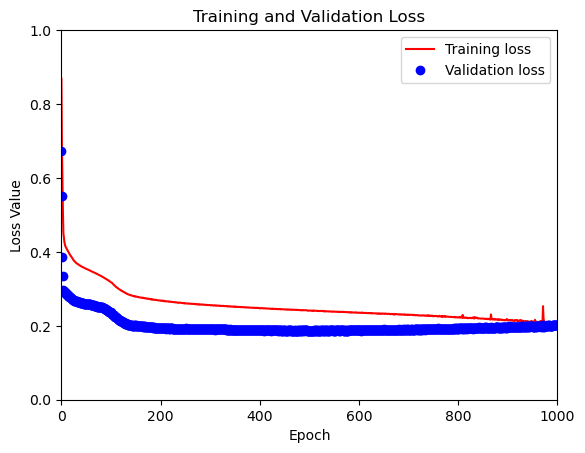

In [5]:
## Training and Validation Loss (L-curve)
import matplotlib.pyplot as plt
# produces L-curve 
loss = unet_model.history.history['loss']
val_loss = unet_model.history.history['val_loss']

plt.figure()
plt.plot( loss, 'r', label='Training loss')
plt.plot( val_loss, 'bo', label='Validation loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss Value')
plt.xlim([0, 1000])
plt.ylim([0, 1])
plt.legend()
plt.show()
#plt.savefig("training_validation_loss_HVsingle_9_26.png")

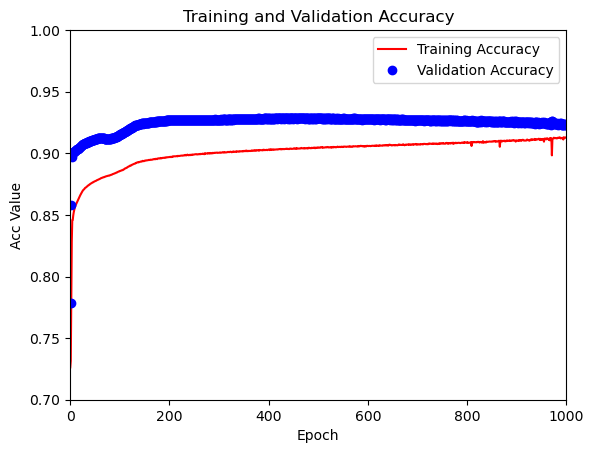

In [6]:
## Training and Validation Accuracy L-curve
acc = unet_model.history.history['sparse_categorical_accuracy']
val_acc = unet_model.history.history['val_sparse_categorical_accuracy']
# produces L-curve (monitor elbow of the L)
plt.figure()
plt.plot( acc, 'r', label='Training Accuracy')
plt.plot( val_acc, 'bo', label='Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Acc Value')
plt.xlim([0, 1000])
plt.ylim([0.7, 1])
plt.legend()
plt.show()

In [3]:
# Launch Tensorboard with the appropriate log directory (if subdirectories are not mentioned, then all runs will be displayed)
# Also mention port could be 6007, 6008 onwards. The d"efault is 6006. In case if a tensorboard is already running, use a different port to launch a new instance ig
%tensorboard --logdir crevasse_data --port=6022

4/4 [==============================] - 0s 44ms/step


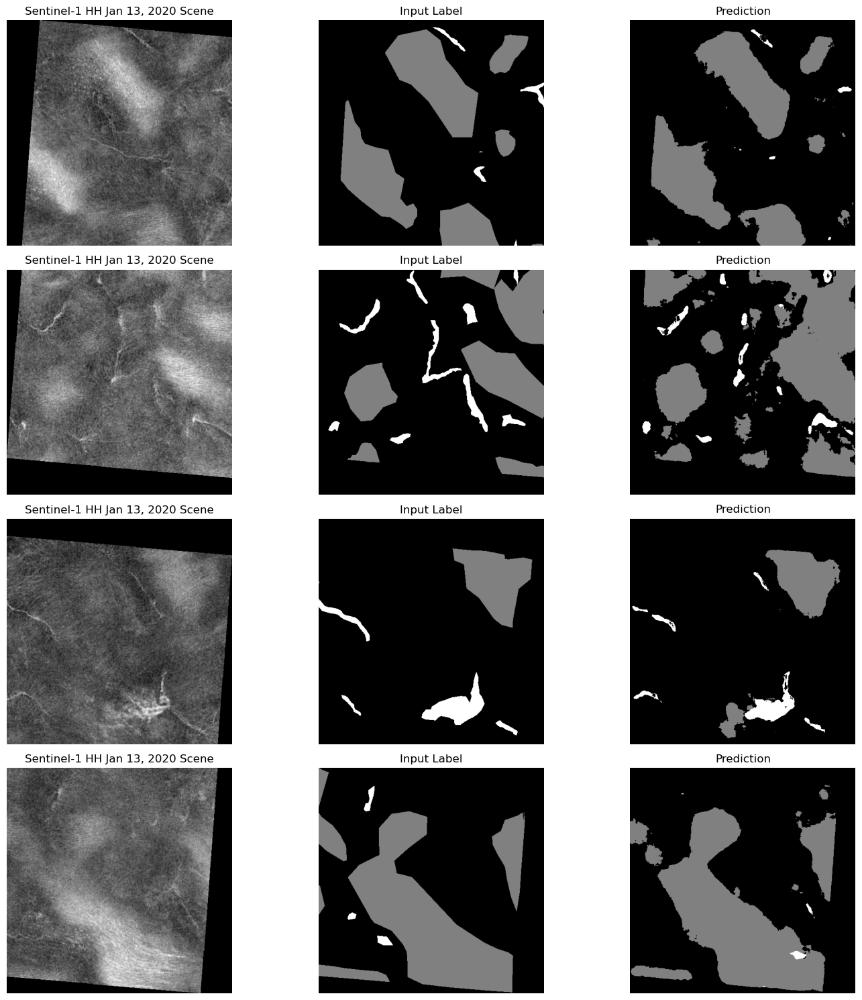

In [7]:
# In the case if the kernel dies, load the saved model using path 
#Nov6_T23_01_41 = tf.keras.models.load_model('./crevasse_data/2023-11-06T23-01_41')
valid_test = unet_model.predict(valid_ds.batch(batch_size=1))
#valid_test_evaluation = Nov6_T23_01_41.evaluate(valid_ds.batch(batch_size=1))
import matplotlib.pyplot as plt
from unet import utils
import numpy as np
fig, ax = plt.subplots(4, 3, sharex=True, sharey=True, figsize=(15,15))
dataset = valid_ds.map(utils.crop_image_and_label_to_shape(valid_test.shape[1:]))

for i, (image, label) in enumerate(dataset.take(4)):
    ax[i][0].imshow(image[..., -1],cmap=plt.cm.gray); ax[i][0].set_title('Sentinel-1 HH Jan 13, 2020 Scene'); ax[i][0].axis('off')
    ax[i][1].imshow(label[...],cmap=plt.cm.gray); ax[i][1].set_title('Input Label'); ax[i][1].axis('off')
    ax[i][2].imshow(np.argmax(valid_test[i,...],axis=-1),cmap=plt.cm.gray); ax[i][2].set_title('Prediction'); ax[i][2].axis('off')
plt.tight_layout()

#### Test on Isunnguata and Russell Sentinel-1 Images

In [ ]:
# In the case if the kernel dies, load the saved model using path

# SGD testing
Nov11_T22_16_12 = tf.keras.models.load_model('./crevasse_data/2023-11-11T22-16_12')
Nov12_T16_49_37 = tf.keras.models.load_model('./crevasse_data/2023-11-12T16-49_37')

# Adam optimizer testing
Nov12_T20_03_13 = tf.keras.models.load_model('./crevasse_data/2023-11-12T20-03_13')
Nov12_T23_05_02 = tf.keras.models.load_model('./crevasse_data/2023-11-12T23-05_02')
Nov13_T12_56_13 = tf.keras.models.load_model('./crevasse_data/2023-11-13T12-56_13')
Nov13_T15_43_43 = tf.keras.models.load_model('./crevasse_data/2023-11-13T15-43_43')

# Load images as TF dataset
image_dataset = tf.data.Dataset.list_files("./gris/Isunnguata and Russell/512/*.png", shuffle=False)
IMG_SIZE = (512,512)

#function to read image from file
def read_image(image_name):
    image = tf.io.read_file(image_name)
    image = tf.image.decode_png(image, channels=1)
    image = tf.image.resize(image, IMG_SIZE)
    image = tf.cast(image, tf.float32)/255.0
    return image
image_dataset = image_dataset.map(read_image, num_parallel_calls=tf.data.AUTOTUNE)

# Model Predictions
Nov11_T22_16_12_prediction = Nov11_T22_16_12.predict(image_dataset.batch(batch_size=1))
Nov12_T16_49_37_prediction = Nov12_T16_49_37.predict(image_dataset.batch(batch_size=1))
Nov12_T20_03_13_prediction = Nov12_T20_03_13.predict(image_dataset.batch(batch_size=1))
Nov12_T23_05_02_prediction = Nov12_T23_05_02.predict(image_dataset.batch(batch_size=1))
Nov13_T12_56_13_prediction = Nov13_T12_56_13.predict(image_dataset.batch(batch_size=1))
Nov13_T15_43_43_prediction = Nov13_T15_43_43.predict(image_dataset.batch(batch_size=1))

In [9]:
import matplotlib.pyplot as plt
from unet import utils
import numpy as np
fig, ax = plt.subplots(24, 7, sharex=True, sharey=True, figsize=(50,200))
#dataset = image_dataset.map(utils.crop_labels_to_shape(prediction.shape[1:]))

for i, (image) in enumerate(image_dataset.take(24)):
    ax[i][0].imshow(image[..., -1],cmap=plt.cm.gray); ax[i][0].set_title('Image'); ax[i][0].axis('off')
    ax[i][1].imshow(np.argmax(Nov11_T22_16_12_prediction[i,...],axis=-1),cmap=plt.cm.gray); ax[i][1].set_title('Nov11_T22_16_12'); ax[i][1].axis('off')
    ax[i][2].imshow(np.argmax(Nov12_T16_49_37_prediction[i,...],axis=-1),cmap=plt.cm.gray); ax[i][2].set_title('Nov12_T16_49_37'); ax[i][2].axis('off')
    ax[i][3].imshow(np.argmax(Nov12_T20_03_13_prediction[i,...],axis=-1),cmap=plt.cm.gray); ax[i][3].set_title('Nov12_T20_03_13'); ax[i][3].axis('off')
    ax[i][4].imshow(np.argmax(Nov12_T23_05_02_prediction[i,...],axis=-1),cmap=plt.cm.gray); ax[i][4].set_title('Nov12_T23_05_02'); ax[i][4].axis('off')
    ax[i][5].imshow(np.argmax(Nov13_T12_56_13_prediction[i,...],axis=-1),cmap=plt.cm.gray); ax[i][5].set_title('Nov13_T12_56_13'); ax[i][5].axis('off')
    ax[i][6].imshow(np.argmax(Nov13_T15_43_43_prediction[i,...],axis=-1),cmap=plt.cm.gray); ax[i][6].set_title('Nov13_T15_43_43'); ax[i][6].axis('off')
plt.tight_layout()

In [ ]:
# In the case if the kernel dies, load the saved model using path 
Nov13_T15_43_43 = tf.keras.models.load_model('./crevasse_data/2023-11-13T15-43_43')
# Load images as TF dataset
image_1024_dataset = tf.data.Dataset.list_files("./gris/Isunnguata and Russell/1024/*.png", shuffle=False)
IMG_SIZE = (1024,1024)
#function to read image and mask from file
def read_1024_image(image_name):
    image = tf.io.read_file(image_name)
    image = tf.image.decode_png(image, channels=1)
    image = tf.image.resize(image, IMG_SIZE)
    image = tf.cast(image, tf.float32)/255.0
    return image
image_1024_dataset = image_1024_dataset.map(read_1024_image, num_parallel_calls=tf.data.AUTOTUNE)

prediction = Nov13_T15_43_43.predict(image_1024_dataset.batch(batch_size=1))

import matplotlib.pyplot as plt
from unet import utils
import numpy as np
fig, ax = plt.subplots(6, 2, sharex=True, sharey=True, figsize=(12,12))
#dataset = image_dataset.map(utils.crop_labels_to_shape(prediction.shape[1:]))

for i, (image) in enumerate(image_1024_dataset.take(6)):
    ax[i][0].imshow(image[..., -1],cmap=plt.cm.gray); ax[i][0].set_title('Sentinel-1 Scene'); ax[i][0].axis('off')
    ax[i][1].imshow(np.argmax(prediction[i,...],axis=-1),cmap=plt.cm.gray); ax[i][1].set_title('Prediction'); ax[i][1].axis('off')
plt.tight_layout()

## Test Model Prediction on HH-single, HV-single, HV-median Sentinel-1 Images

In [25]:
# Load HH single images as TF dataset
HH_single_image_dataset = tf.data.Dataset.list_files("./gris/Images_HH_single/Valid/*.png", shuffle=False)
HH_single_image_dataset = HH_single_image_dataset.map(read_image, num_parallel_calls=tf.data.AUTOTUNE)

# Load HV single images as TF dataset
HV_single_image_dataset = tf.data.Dataset.list_files("./gris/Images_HV_single/Valid/*.png", shuffle=False)
HV_single_image_dataset = HV_single_image_dataset.map(read_image, num_parallel_calls=tf.data.AUTOTUNE)

# Load HV Median images as TF dataset
HV_med_image_dataset = tf.data.Dataset.list_files("./gris/Images_HV_median/Valid/*.png", shuffle=False)
HV_med_image_dataset = HV_med_image_dataset.map(read_image, num_parallel_calls=tf.data.AUTOTUNE)

# Load validation Labels (same labels for all modes)
test_label_dataset = tf.data.Dataset.list_files("./gris/Labels_512/Valid/*.png", shuffle=False)
test_label_dataset = test_label_dataset.map(read_mask, num_parallel_calls=tf.data.AUTOTUNE)

# Zip labels with individual mode image datasets
HH_single_ds = tf.data.Dataset.zip((HH_single_image_dataset,test_label_dataset))
HV_single_ds = tf.data.Dataset.zip((HV_single_image_dataset,test_label_dataset))
HV_med_ds = tf.data.Dataset.zip((HV_med_image_dataset,test_label_dataset))

### HH-single Prediction and Evaluation Metrics

In [26]:
HH_single_prediction = unet_model.predict(HH_single_ds.batch(batch_size=1))
HH_single_evaluation = unet_model.evaluate(HH_single_ds.batch(batch_size=1))

4/4 [==============================] - 0s 70ms/step - loss: 1.0239 - sparse_categorical_accuracy: 0.4148 - sparse_categorical_crossentropy: 1.0239 - io_u_1: 0.7364 - mean_iou: 0.3017 - dice_coefficient: 0.6095


### HV-single Prediction and Evaluation Metrics

In [27]:
HV_single_prediction = unet_model.predict(HV_single_ds.batch(batch_size=1))
HV_single_evaluation = unet_model.evaluate(HV_single_ds.batch(batch_size=1))

4/4 [==============================] - 0s 66ms/step - loss: 1.2011 - sparse_categorical_accuracy: 0.4042 - sparse_categorical_crossentropy: 1.2011 - io_u_1: 0.7364 - mean_iou: 0.3000 - dice_coefficient: 0.6088


### HV-median Prediction and Evaluation Metrics

In [28]:
HV_med_prediction = unet_model.predict(HV_med_ds.batch(batch_size=1))
HV_med_evaluation = unet_model.evaluate(HV_med_ds.batch(batch_size=1))

4/4 [==============================] - 0s 68ms/step - loss: 0.6656 - sparse_categorical_accuracy: 0.6919 - sparse_categorical_crossentropy: 0.6656 - io_u_1: 0.7364 - mean_iou: 0.3043 - dice_coefficient: 0.6093


### Prediction Plot for HH-single images

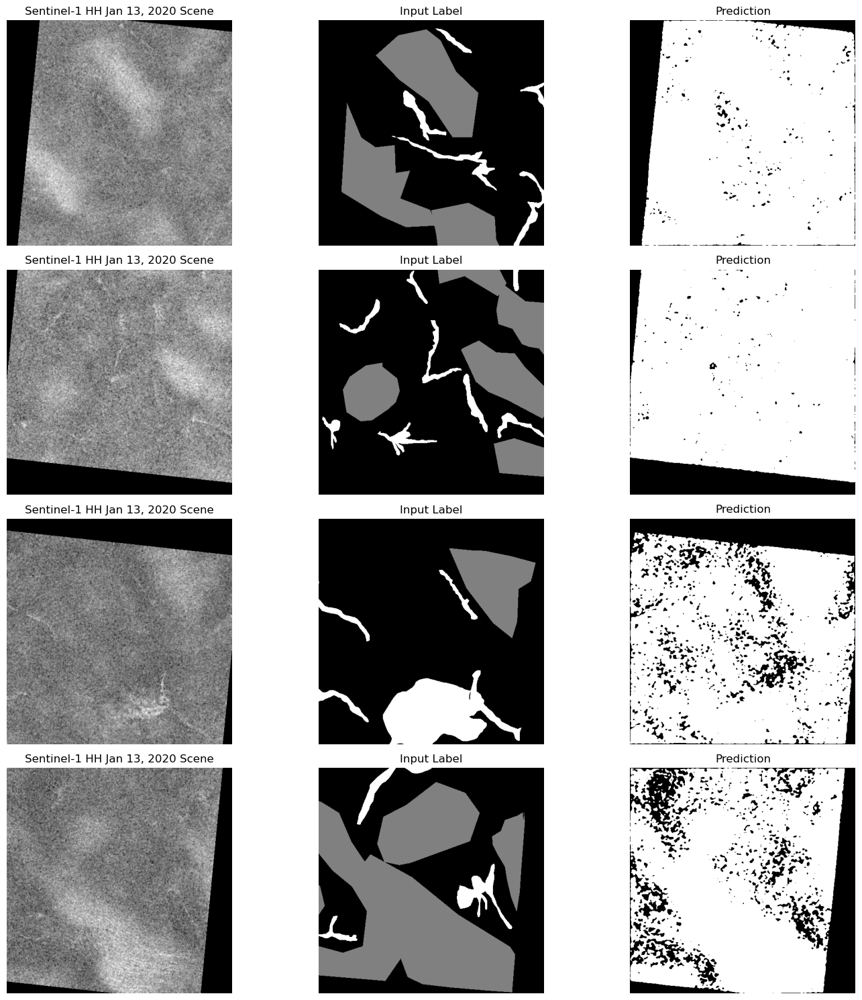

In [43]:
from unet import utils
import numpy as np
fig, ax = plt.subplots(4, 3, sharex=True, sharey=True, figsize=(15,15))
dataset = HH_single_ds.map(utils.crop_image_and_label_to_shape(HH_single_prediction.shape[1:]))

for i, (image, label) in enumerate(dataset.take(4)):
    ax[i][0].imshow(image[..., -1],cmap=plt.cm.gray); ax[i][0].set_title('Sentinel-1 HH Jan 13, 2020 Scene'); ax[i][0].axis('off')
    ax[i][1].imshow(label[...],cmap=plt.cm.gray); ax[i][1].set_title('Input Label'); ax[i][1].axis('off')
    ax[i][2].imshow(np.argmax(HH_single_prediction[i,...],axis=-1),cmap=plt.cm.gray); ax[i][2].set_title('Prediction'); ax[i][2].axis('off')
plt.tight_layout()

### Prediction Plot for HV-single images

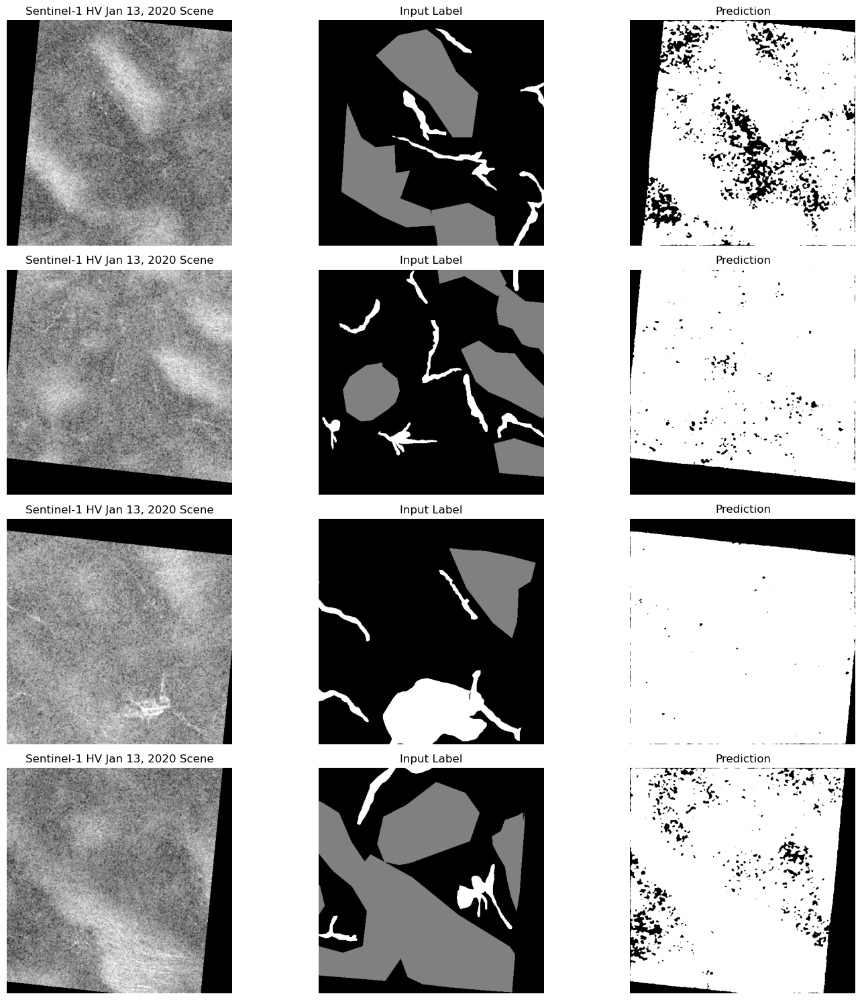

In [44]:
from unet import utils
import numpy as np
fig, ax = plt.subplots(4, 3, sharex=True, sharey=True, figsize=(15,15))
dataset = HV_single_ds.map(utils.crop_image_and_label_to_shape(HV_single_prediction.shape[1:]))

for i, (image, label) in enumerate(dataset.take(4)):
    ax[i][0].imshow(image[..., -1],cmap=plt.cm.gray); ax[i][0].set_title('Sentinel-1 HV Jan 13, 2020 Scene'); ax[i][0].axis('off')
    ax[i][1].imshow(label[...],cmap=plt.cm.gray); ax[i][1].set_title('Input Label'); ax[i][1].axis('off')
    ax[i][2].imshow(np.argmax(HV_single_prediction[i,...],axis=-1),cmap=plt.cm.gray); ax[i][2].set_title('Prediction'); ax[i][2].axis('off')
plt.tight_layout()

### Prediction Plot for HV-median images

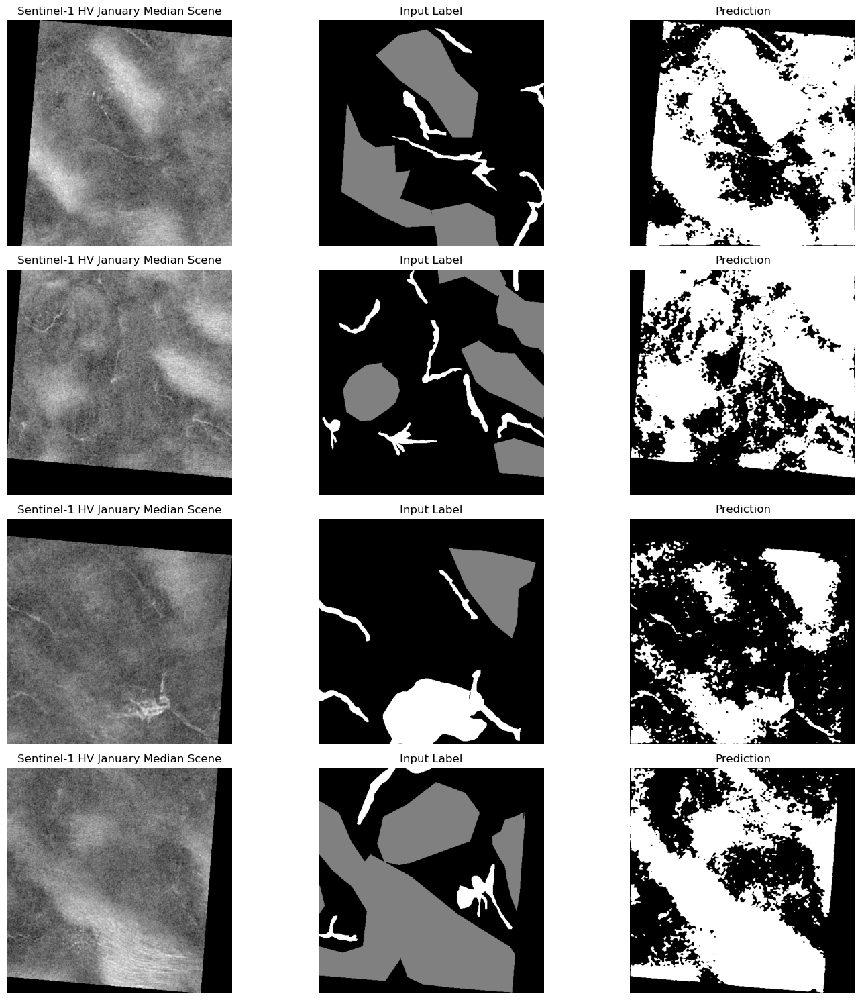

In [45]:
from unet import utils
import numpy as np
fig, ax = plt.subplots(4, 3, sharex=True, sharey=True, figsize=(15,15))
dataset = HV_med_ds.map(utils.crop_image_and_label_to_shape(HV_med_prediction.shape[1:]))

for i, (image, label) in enumerate(dataset.take(4)):
    ax[i][0].imshow(image[..., -1],cmap=plt.cm.gray); ax[i][0].set_title('Sentinel-1 HV January Median Scene'); ax[i][0].axis('off')
    ax[i][1].imshow(label[...],cmap=plt.cm.gray); ax[i][1].set_title('Input Label'); ax[i][1].axis('off')
    ax[i][2].imshow(np.argmax(HV_med_prediction[i,...],axis=-1),cmap=plt.cm.gray); ax[i][2].set_title('Prediction'); ax[i][2].axis('off')
plt.tight_layout()